In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import os

from sklearn.preprocessing import LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

import secrets

from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, GridSearchCV
from sklearn.metrics import confusion_matrix, classification_report, \
                            roc_auc_score , accuracy_score, precision_score, auc, recall_score
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.metrics import f1_score

from sklearn.ensemble import VotingClassifier
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from xgboost import XGBClassifier
import pickle

test_set_percent = 0.15
random_state = 10

In [2]:
def define_metrics(pred_train, pred_test, y_train,y_test, name):
    auc_train = roc_auc_score(y_train, pred_train)
    auc_test = roc_auc_score(y_test, pred_test)
    
    metric_train = pd.DataFrame({'name': [name + '_train'],
                'accuracy' : [accuracy_score(y_train.values, pred_train)], 
              'auc': [auc_train],
              'gini': [2*auc_train - 1],
              'precision': [precision_score(y_train, pred_train)],
              'recall': [recall_score(y_train, pred_train)],

             })
    metric_test = pd.DataFrame({'name': [name + '_test'],
                                'accuracy' : [accuracy_score(y_test, pred_test)], 
                              'auc': [auc_test],
                              'gini': [2*auc_test - 1],
                              'precision': [precision_score(y_test, pred_test)],
                              'recall': [recall_score(y_test, pred_test)],
                                'f1_score': [f1_score(y_test, pred_test)]
                })
    
    return metric_train, metric_test 

In [158]:
def get_score_for_model(models, X_train, y_train, n_splits=10,scoring='roc_auc', print_res=True):
    seed = 13
    
    results = []
    names = []
    scoring = scoring

    for name, model in models:
        strat = StratifiedKFold(n_splits=n_splits, random_state=seed, shuffle=True)

        cv_results = cross_val_score(model, X_train, y_train, cv=strat, scoring=scoring, n_jobs=-1)

        results.append(cv_results)
        names.append(name)
        
        if print_res:
            print(f"{name}: {cv_results.mean()} ({cv_results.std()})")
        
    return np.array(results)

In [4]:
def append_res_to_boxplot(results, df):
    i = 0
    while i < len(results[0]):
        line = []
        for num, ml in zip(results, mod_list): 
            line.append([num[i],ml])

        i = i+1
        df = df.append(pd.DataFrame(line, columns=['Score', 'ML']),ignore_index=True)
    return df

In [5]:
def scores_features(names_models, count_features, scores):
    return pd.DataFrame({'names': names_models, f'features_{count_features}': scores})

In [6]:
df_tabular = pd.read_csv("data/tabular_data.csv")
df_hashed = pd.read_csv("data/hashed_feature.csv")
df_train_target = pd.read_csv("data/train.csv")
df_test_target = pd.read_csv("data/test.csv")

# Exploratory Data Analysis

### tabular_data.csv

In [5]:
df_tabular.shape

(61272, 52)

In [6]:
df_tabular.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61272 entries, 0 to 61271
Data columns (total 52 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   id          61272 non-null  int64  
 1   period      61272 non-null  int64  
 2   feature_0   58460 non-null  float64
 3   feature_1   58380 non-null  float64
 4   feature_2   57795 non-null  float64
 5   feature_3   58314 non-null  float64
 6   feature_4   58425 non-null  float64
 7   feature_5   58257 non-null  float64
 8   feature_6   57814 non-null  float64
 9   feature_7   58280 non-null  float64
 10  feature_8   58338 non-null  float64
 11  feature_9   58344 non-null  float64
 12  feature_10  58318 non-null  float64
 13  feature_11  58184 non-null  float64
 14  feature_12  57847 non-null  float64
 15  feature_13  57938 non-null  float64
 16  feature_14  58366 non-null  float64
 17  feature_15  58410 non-null  float64
 18  feature_16  58193 non-null  float64
 19  feature_17  61272 non-nul

In [7]:
df_tabular.feature_25

0        f9ae10397ed62e79c644d06842bbcd92963a5927
1        f9ae10397ed62e79c644d06842bbcd92963a5927
2        f9ae10397ed62e79c644d06842bbcd92963a5927
3        f9ae10397ed62e79c644d06842bbcd92963a5927
4        11e623a37e87cf7995c466723ec99688d55cae8c
                           ...                   
61267    b204e1e3743cc314841070435211e25f4602b9fd
61268    b204e1e3743cc314841070435211e25f4602b9fd
61269    b204e1e3743cc314841070435211e25f4602b9fd
61270    b204e1e3743cc314841070435211e25f4602b9fd
61271    b204e1e3743cc314841070435211e25f4602b9fd
Name: feature_25, Length: 61272, dtype: object

In [8]:
df_tabular.feature_25.isnull().values.any()

False

`feature_25` does not have missing values. And we can convert to number

In [9]:
df_tabular.feature_25 = df_tabular.feature_25.astype('category')

heatmap with missing values

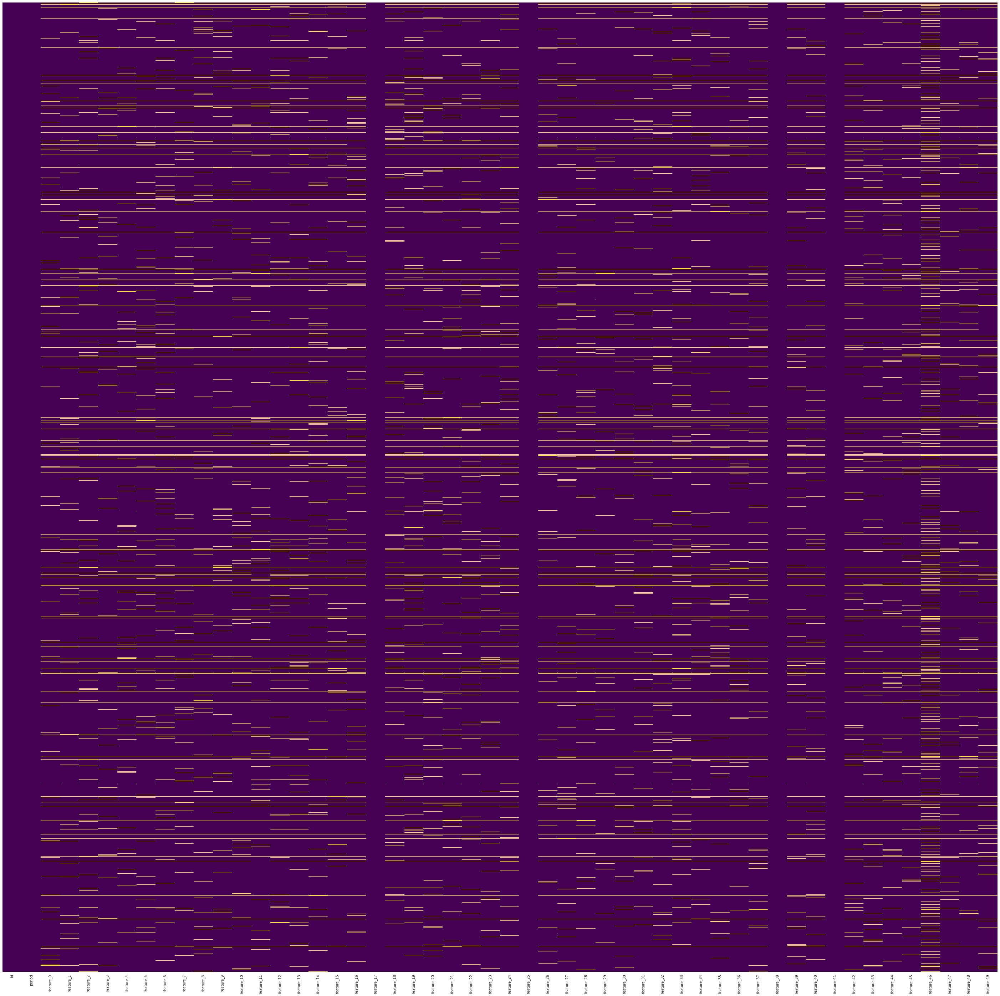

In [12]:
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(50, 50))
    ax = sns.heatmap(df_tabular.isnull(),cbar=False,yticklabels=False,cmap = 'viridis')
#     plt.savefig('mising_data.jpg')

In [14]:
df_tabular.feature_25

0        4
1        4
2        4
3        4
4        6
        ..
61267    2
61268    2
61269    2
61270    2
61271    2
Name: feature_25, Length: 61272, dtype: category
Categories (8, int64): [6, 5, 8, 2, 1, 7, 3, 4]

In [15]:
df_tabular.head()

,id,period,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,...,feature_40,feature_41,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49
0,0,1,110.0,55.0,0.432017,0.000000,176.78,0.0,0.323712,NaN,...,0.00,0,0.000000,0.0,55.0,2.0,0.526552,145.0,133.28,0.0
1,0,2,110.0,110.0,0.397517,0.000000,315.42,0.0,0.316798,NaN,...,0.00,0,0.000000,0.0,110.0,1.0,0.481063,130.0,229.97,0.0
2,0,3,110.0,55.0,0.359440,0.000000,354.55,0.0,0.339188,NaN,...,0.07,0,0.000000,0.0,55.0,1.0,0.509598,180.0,231.78,0.0
3,0,4,110.0,55.0,0.285707,0.000000,229.98,0.0,0.415428,NaN,...,0.00,0,0.000000,0.0,55.0,0.0,0.680089,142.0,183.83,0.0
4,0,5,110.0,55.0,0.101487,444.730391,307.12,0.0,0.569670,NaN,...,0.95,0,20.014485,0.0,55.0,0.0,0.776175,85.0,155.83,0.0


In [16]:
df_tabular.describe().loc[:, 'id':'feature_17']

,id,period,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,feature_11,feature_12,feature_13,feature_14,feature_15,feature_16,feature_17
count,61272.000000,61272.000000,58460.000000,58380.000000,57795.000000,58314.000000,58425.000000,58257.000000,57814.000000,58280.000000,58338.000000,58344.000000,58318.000000,58184.000000,57847.000000,57938.000000,58366.000000,58410.000000,58193.000000,61272.000000
mean,2552.500000,6.500000,110.070493,87.142409,0.305150,3003.454276,414.703826,1466.527398,0.576053,391.127914,125.101255,114.737443,388.728984,1009.457709,0.287931,0.050513,3.155639,10.821589,363.889708,0.499903
std,1473.987237,3.452081,0.465371,95.507541,0.746314,11218.392268,524.216185,7356.174585,0.738444,436.314898,145.203774,661.855299,512.211932,6182.586735,0.111642,0.087219,24.529224,14.111705,2406.061731,0.289287
min,0.000000,1.000000,110.000000,-4.250000,0.000000,0.000000,0.000000,0.000000,0.000002,0.000000,-1755.000000,0.000000,0.000000,-1857.710000,0.000000,-1.000000,0.000000,-31.000000,0.000000,0.000001
25%,1276.000000,3.750000,110.000000,45.000000,0.059522,0.000000,70.320000,0.000000,0.247418,99.295000,39.000000,0.000000,54.740000,35.000000,0.207877,0.005089,0.000000,0.000000,0.000000,0.247295
50%,2552.500000,6.500000,110.000000,75.000000,0.147504,10.898701,254.950000,0.000000,0.492813,262.430000,100.000000,3.450000,226.960000,70.500000,0.292973,0.021653,0.000000,2.000000,0.000000,0.498526
75%,3829.000000,9.250000,110.000000,114.000000,0.321111,1809.999746,566.530000,0.000000,0.698059,535.162500,184.000000,23.300000,529.122500,110.850000,0.364436,0.066905,1.000000,27.000000,1.000000,0.752020
max,5105.000000,12.000000,119.000000,7989.000000,5.474424,557998.502178,10335.280000,334448.528357,5.499928,7950.650000,1762.000000,4954.493685,10302.850000,43938.825831,0.799732,1.000000,2228.000000,31.000000,17231.157402,0.999965


In [17]:
df_tabular.describe().loc[:, 'feature_18':'feature_37']

,feature_18,feature_19,feature_20,feature_21,feature_22,feature_23,feature_24,feature_26,feature_27,feature_28,feature_29,feature_30,feature_31,feature_32,feature_33,feature_34,feature_35,feature_36,feature_37
count,58212.000000,57708.000000,58331.000000,58463.000000,58399.000000,58173.000000,58321.000000,58604.000000,58373.000000,58274.000000,58810.000000,58457.000000,58354.000000,58270.000000,57494.000000,58387.000000,58255.000000,58445.000000,58409.000000
mean,417.464495,0.227281,70.269164,11.901861,958.070795,27.880013,3.099158,100.387823,4.873682,20.632075,1851.145168,131.571121,2958.747901,133.563480,0.231423,86.755117,1478.685268,100.235933,4.941925
std,445.821333,0.111598,60.744476,54.744476,5974.881448,37.923651,24.016987,119.450853,12.779626,45.393407,11954.561123,149.997946,1723.916883,174.027542,0.161397,70.676962,8254.261078,147.057407,25.539829
min,0.000000,0.000000,0.000000,-4.250000,-4.250000,-300.000000,0.000000,0.000000,0.000000,-464.620000,0.000000,0.000000,0.000000,-2362.000000,0.000000,-227.000000,0.000000,0.000000,0.000000
25%,117.420000,0.134781,35.000000,0.000000,45.000000,4.000000,0.000000,23.000000,0.000000,0.220000,0.000000,31.000000,1587.000000,29.000000,0.082152,43.000000,0.000000,9.050000,0.000000
50%,290.350000,0.223581,62.000000,0.940000,75.000000,19.000000,0.000000,69.000000,0.000000,5.600000,66.000000,92.000000,2489.000000,99.000000,0.213396,79.000000,0.000000,50.480000,0.000000
75%,570.907500,0.317355,95.000000,8.400000,116.005000,42.000000,1.000000,139.000000,3.420000,24.170000,110.000000,183.000000,4610.000000,199.000000,0.359638,149.000000,476.675311,133.150000,0.000000
max,7951.030000,0.700195,1189.000000,6900.000000,43936.064713,902.000000,1580.000000,4419.000000,263.370000,1163.050000,86423.542768,4708.000000,7143.000000,4723.000000,0.897573,234.000000,565227.325781,3824.070000,900.000000


In [18]:
df_tabular.describe().loc[:, 'feature_38':]

,feature_38,feature_39,feature_40,feature_41,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49
count,61272.000000,58415.000000,58402.000000,61272.0,58389.000000,58218.000000,58428.000000,58307.000000,53036.000000,58418.000000,58368.000000,58397.000000
mean,0.024942,2.864665,2.389240,0.0,451.453999,1.092617,70.045547,12.617404,0.420170,125.407494,288.885904,62.298690
std,0.126317,28.304415,12.291543,0.0,2784.078472,2.989411,60.523556,22.794809,0.402705,123.970687,380.992122,341.761943
min,0.000000,0.000000,-234.610000,0.0,-71832.185113,0.000000,0.000000,0.000000,-0.999903,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,35.000000,1.000000,0.084032,39.000000,38.845000,0.000000
50%,0.000000,0.000000,0.150000,0.0,0.000000,0.000000,61.580000,5.000000,0.412981,94.000000,168.250000,3.000000
75%,0.000000,0.000000,1.630000,0.0,17.765874,1.000000,95.000000,14.000000,0.791630,173.000000,393.807500,13.000000
max,0.999977,2162.720000,1063.930000,0.0,150799.228494,31.000000,1189.000000,504.000000,0.999941,1724.000000,8201.170000,2452.540251


In [19]:
# 12 equal periods
df_tabular['period'].value_counts()

12    5106
11    5106
10    5106
9     5106
8     5106
7     5106
6     5106
5     5106
4     5106
3     5106
2     5106
1     5106
Name: period, dtype: int64

## Drop empy value and see how data dependens 

In [20]:
df_tabular_dropna = df_tabular.dropna()
df_tabular_dropna = df_tabular_dropna.merge(df_train_target)
df_tabular_dropna.target = df_tabular_dropna.target.astype('category')

df_tabular_dropna

,id,period,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,...,feature_41,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49,target
0,3,1,110.0,33.50,0.008239,266.829103,127.92,0.000000,0.695500,234.57,...,0,0.005484,1.0,3.19,1.0,0.679096,153.0,93.30,9.0,0
1,5,1,110.0,148.70,0.072566,1082.113139,490.33,897.676285,0.026950,370.58,...,0,176.126794,1.0,145.00,3.0,0.183837,151.0,309.83,3.0,0
2,5,2,110.0,145.00,0.054864,3906.750156,520.33,3846.831071,0.079840,388.12,...,0,50.151560,0.0,145.00,0.0,0.196953,118.0,457.05,1.0,0
3,5,3,110.0,80.00,0.079222,863.524972,395.70,742.026400,0.023619,342.93,...,0,9.568069,1.0,78.00,2.0,0.215208,150.0,238.22,2.0,0
4,5,4,110.0,195.00,0.132736,1743.897454,314.72,1716.332785,0.069701,263.07,...,0,3.097497,0.0,135.00,0.0,0.096070,91.0,245.45,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16791,4081,7,110.0,60.00,0.471313,0.000000,39.32,0.000000,0.142434,36.63,...,0,0.000000,0.0,38.00,56.0,0.671391,23.0,26.55,2.0,0
16792,4081,8,110.0,40.49,0.532415,0.000000,18.65,0.000000,0.113847,150.30,...,0,0.000000,0.0,40.49,18.0,0.228105,10.0,2.85,0.0,0
16793,4081,9,110.0,52.00,0.588743,0.000000,10.60,0.000000,0.242236,256.18,...,0,0.000000,0.0,50.00,19.0,0.325495,38.0,10.38,0.0,0
16794,4081,10,110.0,0.00,0.764390,0.000000,65.18,0.000000,0.059876,207.08,...,0,0.000000,0.0,0.00,7.0,0.359551,33.0,30.22,3.0,0


In [21]:
df_tabular_dropna.describe()

,id,period,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,...,feature_40,feature_41,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49
count,16796.000000,16796.000000,16796.000000,16796.000000,16796.000000,16796.000000,16796.000000,16796.000000,16796.000000,16796.000000,...,16796.000000,16796.0,16796.000000,16796.000000,16796.000000,16796.000000,16796.000000,16796.000000,16796.000000,16796.000000
mean,2024.608121,5.944332,110.031138,89.413112,0.308302,3141.873771,409.660736,1372.084156,0.578260,392.489496,...,2.556211,0.0,374.575226,1.046023,72.546875,12.283520,0.419714,128.817397,288.492314,58.555681
std,1185.702028,3.169490,0.211139,91.304657,0.759155,14185.080013,489.829202,7149.005792,0.738557,435.519282,...,14.744552,0.0,2354.662086,2.822774,62.691895,20.970303,0.399711,132.364570,362.421899,328.577991
min,3.000000,1.000000,110.000000,-4.250000,0.000000,0.000000,0.000000,0.000000,0.000002,0.000000,...,-67.610000,0.0,-65001.384930,0.000000,0.000000,0.000000,-0.998458,0.000000,0.000000,0.000000
25%,1009.000000,3.000000,110.000000,45.000000,0.059542,0.000000,71.502500,0.000000,0.247158,101.780000,...,0.000000,0.0,0.000000,0.000000,35.000000,1.000000,0.088164,39.000000,39.977500,0.000000
50%,2029.500000,6.000000,110.000000,75.000000,0.147861,14.510352,257.900000,0.000000,0.494422,260.340000,...,0.170000,0.0,0.000088,0.000000,65.000000,5.000000,0.401014,94.000000,170.750000,3.000000
75%,3026.000000,9.000000,110.000000,115.000000,0.321041,1747.979300,572.050000,0.000000,0.702912,537.920000,...,1.690000,0.0,16.719637,1.000000,95.735000,14.000000,0.792851,176.000000,405.072500,13.000000
max,4081.000000,11.000000,113.000000,2680.650000,5.474424,557998.502178,5767.530000,227032.345767,5.499694,6035.820000,...,1063.930000,0.0,150799.228494,31.000000,760.000000,284.000000,0.999927,1724.000000,4536.270000,2452.118477


In [22]:
df_tabular_dropna

,id,period,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,...,feature_41,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49,target
0,3,1,110.0,33.50,0.008239,266.829103,127.92,0.000000,0.695500,234.57,...,0,0.005484,1.0,3.19,1.0,0.679096,153.0,93.30,9.0,0
1,5,1,110.0,148.70,0.072566,1082.113139,490.33,897.676285,0.026950,370.58,...,0,176.126794,1.0,145.00,3.0,0.183837,151.0,309.83,3.0,0
2,5,2,110.0,145.00,0.054864,3906.750156,520.33,3846.831071,0.079840,388.12,...,0,50.151560,0.0,145.00,0.0,0.196953,118.0,457.05,1.0,0
3,5,3,110.0,80.00,0.079222,863.524972,395.70,742.026400,0.023619,342.93,...,0,9.568069,1.0,78.00,2.0,0.215208,150.0,238.22,2.0,0
4,5,4,110.0,195.00,0.132736,1743.897454,314.72,1716.332785,0.069701,263.07,...,0,3.097497,0.0,135.00,0.0,0.096070,91.0,245.45,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16791,4081,7,110.0,60.00,0.471313,0.000000,39.32,0.000000,0.142434,36.63,...,0,0.000000,0.0,38.00,56.0,0.671391,23.0,26.55,2.0,0
16792,4081,8,110.0,40.49,0.532415,0.000000,18.65,0.000000,0.113847,150.30,...,0,0.000000,0.0,40.49,18.0,0.228105,10.0,2.85,0.0,0
16793,4081,9,110.0,52.00,0.588743,0.000000,10.60,0.000000,0.242236,256.18,...,0,0.000000,0.0,50.00,19.0,0.325495,38.0,10.38,0.0,0
16794,4081,10,110.0,0.00,0.764390,0.000000,65.18,0.000000,0.059876,207.08,...,0,0.000000,0.0,0.00,7.0,0.359551,33.0,30.22,3.0,0


In [23]:
df_tabular_dropna_group = df_tabular_dropna.loc[:,'id':].groupby(['id'],as_index=False).sum()
df_tabular_dropna_group = df_tabular_dropna_group.merge(df_train_target)
df_tabular_dropna_group

,id,period,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,...,feature_41,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49,target
0,3,1,110.0,33.50,0.008239,266.829103,127.92,0.000000,0.695500,234.57,...,0,0.005484,1.0,3.19,1.0,0.679096,153.0,93.30,9.000000,0
1,5,66,1210.0,1381.29,0.917817,16367.380900,6112.02,15522.861965,0.645973,4146.06,...,0,305.790619,4.0,1303.59,39.0,1.519260,1489.0,4583.98,35.000000,0
2,8,66,1214.0,15.00,1.408679,0.004695,2.14,0.000000,6.276137,28.22,...,0,0.000000,0.0,10.00,0.0,7.585375,22.0,1.32,0.000000,1
3,9,66,1210.0,880.50,6.864717,0.058218,5608.77,0.000000,5.301097,9846.62,...,0,0.000000,3.0,870.00,82.0,0.231330,640.0,4135.19,4.000000,0
4,11,1,110.0,191.00,0.383468,2428.712040,332.32,1848.408490,0.194868,428.53,...,0,1295.401285,0.0,100.00,1.0,0.176597,40.0,257.57,0.000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1640,4069,15,550.0,398.75,6.869426,0.000000,1143.65,0.000000,2.015777,1681.69,...,0,0.000000,0.0,348.63,160.0,1.441441,408.0,748.20,115.000000,0
1641,4071,66,1214.0,51.50,3.486901,1239.031855,191.92,1172.843630,3.423473,2650.71,...,0,230.027703,1.0,40.00,17.0,0.412515,357.0,78.72,0.000000,0
1642,4072,66,1210.0,129.81,0.540362,3762.343980,1809.00,0.000000,4.787886,4569.35,...,0,898.960270,0.0,101.81,8.0,3.226892,2074.0,1416.03,2378.908992,0
1643,4079,66,1210.0,678.56,4.510298,0.000000,1264.75,0.000000,2.787685,2269.27,...,0,0.000000,2.0,600.00,35.0,4.752337,457.0,832.14,63.000000,0


## Train and Test sets IDs

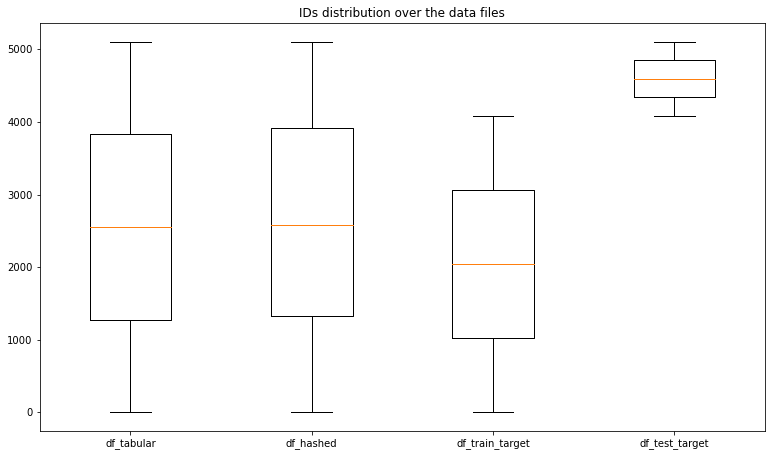

In [87]:
plt.figure(figsize=[13,7.5])
plt.boxplot([df_tabular['id'], df_hashed['id'], df_train_target['id'], df_test_target['id']],
           labels=['df_tabular', 'df_hashed', 'df_train_target', 'df_test_target'])
plt.title('IDs distribution over the data files')
plt.show()

In [88]:
print(f"Train IDs \t from {df_train_target['id'].min()}:{df_train_target['id'].max()}")
print(f"Test IDs \t from {df_test_target['id'].min()}:{df_test_target['id'].max()}")

Train IDs 	 from 0:4083
Test IDs 	 from 4084:5105


### hashed_feature.csv

In [89]:
df_hashed.shape

(266053, 2)

In [90]:
df_hashed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 266053 entries, 0 to 266052
Data columns (total 2 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   id          266053 non-null  int64 
 1   feature_50  265649 non-null  object
dtypes: int64(1), object(1)
memory usage: 4.1+ MB


In [91]:
df_hashed['id'].value_counts()

4517    1278
3503     957
3329     925
4967     774
1885     756
        ... 
3208       1
2145       1
3679       1
3601       1
2226       1
Name: id, Length: 5106, dtype: int64

In [21]:
hlen = []
indexes = []
for i in range(df_hashed['id'].shape[0]):
    hlen.append(df_hashed[df_hashed['id'] == i].shape[0])
    indexes.append(i)

print(f'(min, max): {min(hlen), max(hlen)}')

(min, max): (0, 1278)


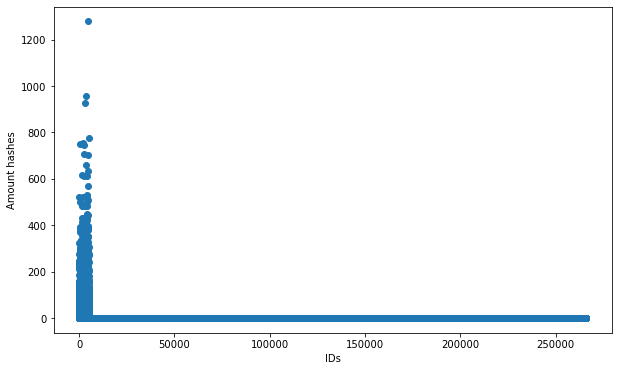

In [22]:
plt.figure(figsize=(10,6));
plt.scatter(x = indexes , y = hlen);
plt.xlabel('IDs');
plt.ylabel('Amount hashes');
plt.show();

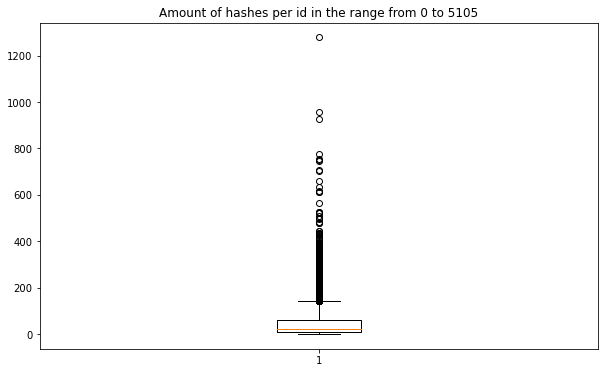

In [23]:
plt.figure(figsize=(10,6));
plt.boxplot(hlen[:5105]);
plt.title('Amount of hashes per id in the range from 0 to 5105');
plt.show();

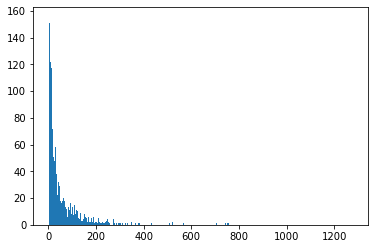

In [24]:
plt.hist(hlen[:5105],bins=1278);

In [92]:
# Removing ids that are not present in our training and test datat
df_hash2 = df_hashed[df_hashed['id']<=5105]

In [93]:
df_hash2.shape

(266053, 2)

In [94]:
df_hash2.feature_50.isnull().any()

True

In [95]:
# Label encoder for hashes

le = LabelEncoder()

imputer = SimpleImputer()

# put mis value as random hash with same len
df_hash2.feature_50 = df_hash2.feature_50.fillna(secrets.token_hex(nbytes=len(df_hash2.feature_50[0])//2)) 

df_hash2['hs'] = le.fit_transform(df_hash2['feature_50'])

In [96]:
df_hash2.head()

,id,feature_50,hs
0,0,7984b0a0e139cabadb5afc7756d473fb34d23819,2367
1,0,47904b3331202e9881d003ff449c2eabfbc75460,1404
2,0,a99c4b3af723874ddd85af322beea81b64437294,3314
3,0,4dce5381031a88aed6b12ef71b6f7c3148e7b3c8,1543
4,0,d62db721202cb6636887f450a7b77fa97db03b05,4180


In [97]:
df_hash2.shape

(266053, 3)

In [98]:
# Dataframe for storing the matrix
df_new_tabular = pd.get_dummies(df_hash2, columns = ['hs']).groupby(['id'],as_index=False).sum()

In [99]:
df_new_tabular.head()

,id,hs_0,hs_1,hs_2,hs_3,hs_4,hs_5,hs_6,hs_7,hs_8,...,hs_5000,hs_5001,hs_5002,hs_5003,hs_5004,hs_5005,hs_5006,hs_5007,hs_5008,hs_5009
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [100]:
df_new_tabular.shape, df_tabular.shape

((5106, 5011), (61272, 50))

### train.csv

In [101]:
df_train_target.shape

(4084, 2)

In [102]:
df_train_target.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4084 entries, 0 to 4083
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   id      4084 non-null   int64
 1   target  4084 non-null   int64
dtypes: int64(2)
memory usage: 63.9 KB


### test.csv

In [103]:
df_test_target.shape

(1022, 2)

In [104]:
df_test_target.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1022 entries, 0 to 1021
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   id      1022 non-null   int64  
 1   score   0 non-null      float64
dtypes: float64(1), int64(1)
memory usage: 16.1 KB


## How good balanced the data

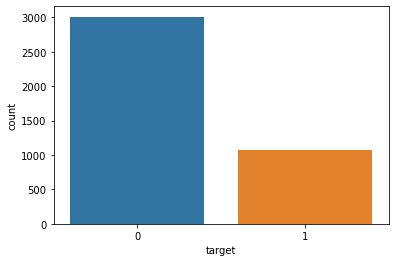

In [105]:
sns.countplot(df_train_target.target, label='Sum')
plt.show()

## Data preparation


In [106]:
df_tabular

,id,period,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,...,feature_39,feature_40,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49
0,0,1,55.0,0.432017,0.000000,176.78,0.0,0.323712,NaN,147.0,...,0.00,0.00,0.000000,0.0,55.0,2.0,0.526552,145.0,133.28,0.0
1,0,2,110.0,0.397517,0.000000,315.42,0.0,0.316798,NaN,135.0,...,15.75,0.00,0.000000,0.0,110.0,1.0,0.481063,130.0,229.97,0.0
2,0,3,55.0,0.359440,0.000000,354.55,0.0,0.339188,NaN,181.0,...,0.00,0.07,0.000000,0.0,55.0,1.0,0.509598,180.0,231.78,0.0
3,0,4,55.0,0.285707,0.000000,229.98,0.0,0.415428,NaN,142.0,...,0.00,0.00,0.000000,0.0,55.0,0.0,0.680089,142.0,183.83,0.0
4,0,5,55.0,0.101487,444.730391,307.12,0.0,0.569670,NaN,92.0,...,26.75,0.95,20.014485,0.0,55.0,0.0,0.776175,85.0,155.83,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61267,5105,8,77.0,NaN,0.000000,95.30,0.0,0.094381,221.85,-44.0,...,6.03,-0.00,0.000000,0.0,75.0,0.0,0.082128,43.0,83.97,0.0
61268,5105,9,77.0,NaN,0.000000,61.87,0.0,0.105878,343.22,52.0,...,17.30,1.75,0.000000,0.0,75.0,0.0,0.077594,49.0,48.02,0.0
61269,5105,10,106.5,NaN,0.000000,88.05,0.0,0.040169,259.33,46.0,...,22.60,8.27,0.000000,0.0,99.0,1.0,0.109053,43.0,74.52,0.0
61270,5105,11,45.0,NaN,0.000000,98.40,0.0,0.040810,222.00,-39.0,...,21.13,0.00,0.000000,0.0,0.0,0.0,0.101929,35.0,25.83,0.0


In [109]:
from sklearn.impute import KNNImputer

n_neighbors=5
imputer = KNNImputer(missing_values=np.nan, n_neighbors=n_neighbors)

df_tabular.loc[:, 'feature_1':'feature_49'] = `''.loc[:, 'feature_1':'feature_49'].fillna(np.nan)
df_tabular.loc[:,'feature_1':'feature_49'] = imputer.fit_transform(df_tabular.loc[:,'feature_1':'feature_49'].values)

In [110]:
df_tabular.to_csv('prepared_data_discretize/features_category.csv', index=False)

In [111]:
df_tabular = df_tabular.loc[:,'id':'feature_49'].groupby(['id'],as_index=False).sum()

In [113]:
df_tabular = df_tabular.drop('period', axis=1)
df_tabular.head()

,id,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_39,feature_40,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49
0,0,731.000,2.866555,3523.629746,5161.610,0.000000,5.343986,4195.400,1772.0,3.740000,...,188.690,5.10,138.431547,0.0,718.50,9.0,5.955901,1714.0,3780.140,3.000000
1,1,1626.500,0.725314,83286.958225,13432.230,0.000000,4.207655,14398.120,1374.0,4792.498484,...,0.000,19.64,40620.522617,1.0,1500.00,81.0,3.482466,1631.0,8115.358,2452.009568
2,2,7.170,44.500822,1.696433,50.020,0.000000,10.500171,312.990,122.0,0.000000,...,0.000,5.48,0.000987,0.0,7.17,0.0,2.502836,121.0,29.640,0.000000
3,3,655.754,17.155935,10278.811182,2765.342,1208.131473,19.851772,2848.646,967.2,2055.233481,...,9.554,27.80,569.790086,4.8,519.70,77.4,5.428860,930.2,2016.230,1488.722387
4,4,1512.000,1.604314,30819.401741,5523.990,0.000000,12.082259,6269.390,2731.0,533.350000,...,6.500,40.58,1955.666336,2.0,1244.80,436.0,9.050331,2284.0,3473.138,2506.932045


In [114]:
# Concat dataframes
df_final = pd.merge(df_tabular, 
                   df_new_tabular, 
                   on = 'id')

In [115]:
df_final.head()

,id,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,hs_5000,hs_5001,hs_5002,hs_5003,hs_5004,hs_5005,hs_5006,hs_5007,hs_5008,hs_5009
0,0,731.000,2.866555,3523.629746,5161.610,0.000000,5.343986,4195.400,1772.0,3.740000,...,0,0,0,0,0,0,0,0,0,0
1,1,1626.500,0.725314,83286.958225,13432.230,0.000000,4.207655,14398.120,1374.0,4792.498484,...,0,0,0,0,0,0,0,0,0,0
2,2,7.170,44.500822,1.696433,50.020,0.000000,10.500171,312.990,122.0,0.000000,...,0,0,0,0,0,0,0,0,0,0
3,3,655.754,17.155935,10278.811182,2765.342,1208.131473,19.851772,2848.646,967.2,2055.233481,...,0,0,0,0,0,0,0,0,0,0
4,4,1512.000,1.604314,30819.401741,5523.990,0.000000,12.082259,6269.390,2731.0,533.350000,...,0,0,0,0,0,0,0,0,0,0


In [116]:
df_final.to_csv('prepared_data_discretize/df_final_category.csv', index=False)

In [117]:
df_tabular.shape, df_new_tabular.shape, df_final.shape

((5106, 49), (5106, 5011), (5106, 5059))

In [118]:
# Identifying missing IDs. 
s1 = set(df_tabular['id'])
s2 = set(df_new_tabular['id'])
s1.difference(s2)

set()

## Scaling

In [80]:
# df_final = pd.read_csv('prepared_data/df_final.csv')

In [120]:
feature_scaler = StandardScaler()
df_final.loc[:, 'feature_1':] = feature_scaler.fit_transform(df_final.loc[:, 'feature_1':])

In [121]:
df_final

,id,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,hs_5000,hs_5001,hs_5002,hs_5003,hs_5004,hs_5005,hs_5006,hs_5007,hs_5008,hs_5009
0,0,-0.336988,-0.289111,-0.297648,0.045206,-0.255115,-0.369467,-0.100240,0.216761,-0.317530,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
1,1,0.656844,-0.529790,0.399689,1.573290,-0.255115,-0.498585,2.182203,-0.085022,0.272281,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
2,2,-1.140299,4.390645,-0.328438,-0.899213,-0.255115,0.216419,-0.968771,-1.034348,-0.317990,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
3,3,-0.420496,1.317038,-0.238590,-0.397529,-0.237154,1.279021,-0.401521,-0.393477,-0.064856,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4,4,0.529771,-0.430989,-0.059012,0.112160,-0.255115,0.396189,0.363731,0.943921,-0.252300,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5101,5101,0.105825,-0.217083,-0.309554,1.792865,-0.237594,-0.342060,2.802171,0.173541,-0.300439,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,7.779336,-0.057797,-0.095346,-0.028,-0.078156
5102,5102,-0.073853,0.408036,-0.328453,-0.430666,-0.255115,0.076892,-0.650119,-0.513128,-0.315329,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
5103,5103,-0.847699,0.469806,-0.328453,-0.586458,-0.255115,0.183896,-0.866735,-0.952457,-0.258101,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
5104,5104,0.000138,-0.518795,-0.224707,-0.747399,-0.255115,-0.229017,-0.840887,-0.533146,-0.309625,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156


In [123]:
# df_final.to_csv('prepared_data_category/df_final_scalled.csv', index=False)

## Split for train, test and choosing features

In [5]:
df_final = pd.read_csv('prepared_data/df_final_scelled.csv')
X = df_final[df_final['id'] <= df_train_target['id'].max()] # Train data without target variable
Test = df_final[df_final['id'] > df_train_target['id'].max()] # Test data for the final submission

In [6]:
# There is one missing id in the test dataset that needs to be inserted on the final stage
Test.shape, df_test_target.shape

((1022, 5062), (1022, 2))

In [7]:
X.head()

,id,period,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,...,hs_5000,hs_5001,hs_5002,hs_5003,hs_5004,hs_5005,hs_5006,hs_5007,hs_5008,hs_5009
0,0,78,-0.273723,-0.336434,-0.289625,-0.289912,0.045595,-0.25460,-0.370406,-0.111834,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
1,1,78,-0.273723,0.657418,-0.531011,0.413251,1.574218,-0.25460,-0.499708,2.183229,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
2,2,78,0.243573,-1.139762,6.365947,-0.320960,-0.899158,-0.25460,0.216312,-0.965038,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
3,3,78,1.019516,-0.357155,1.300319,-0.102735,-0.405043,-0.02706,1.163379,-0.451326,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4,4,78,-0.273723,0.530343,-0.431920,-0.049283,0.112572,-0.25460,0.396337,0.364365,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156


In [8]:
Xy = pd.merge(df_train_target, 
              X, 
              on = 'id')

In [9]:
Xy.head()

,id,target,period,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,...,hs_5000,hs_5001,hs_5002,hs_5003,hs_5004,hs_5005,hs_5006,hs_5007,hs_5008,hs_5009
0,0,0,78,-0.273723,-0.336434,-0.289625,-0.289912,0.045595,-0.25460,-0.370406,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
1,1,0,78,-0.273723,0.657418,-0.531011,0.413251,1.574218,-0.25460,-0.499708,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
2,2,1,78,0.243573,-1.139762,6.365947,-0.320960,-0.899158,-0.25460,0.216312,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
3,3,0,78,1.019516,-0.357155,1.300319,-0.102735,-0.405043,-0.02706,1.163379,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4,4,1,78,-0.273723,0.530343,-0.431920,-0.049283,0.112572,-0.25460,0.396337,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156


In [10]:
X.shape, Xy.shape

((4084, 5062), (4084, 5063))

[MLENS] backend: threading
/home/eduard/anaconda3/envs/ml_coursera/lib/python3.7/site-packages/scipy/stats/stats.py:3845: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/home/eduard/anaconda3/envs/ml_coursera/lib/python3.7/site-packages/mlens/visualization/correlations.py:303: MatplotlibDeprecationWarning: Passing the minor parameter of set_xticks() positionally is deprecated since Matplotlib 3.2; the parameter will become keyword-only two minor releases later.
  ax2.set_xticks([], [])


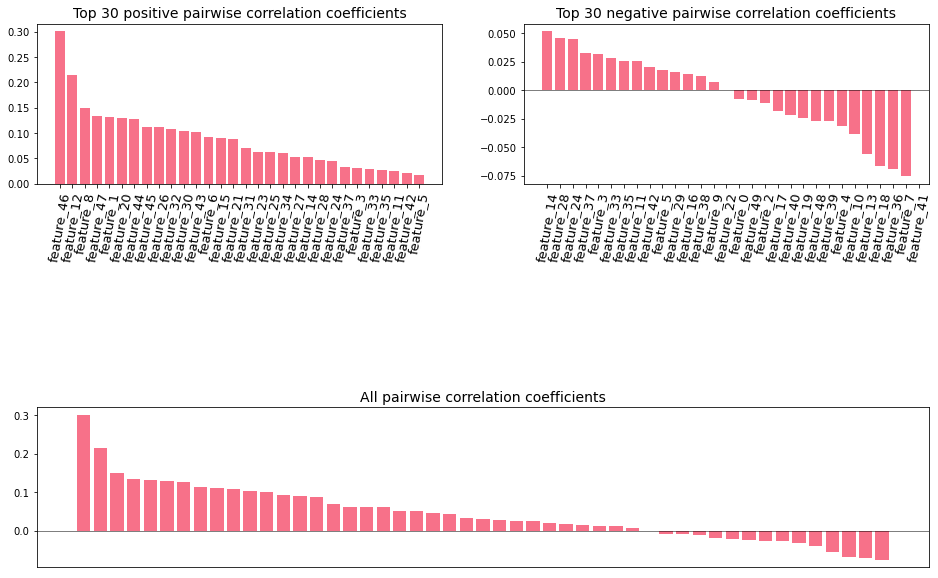

GridSpec(2, 2)

In [11]:
from mlens.visualization import corr_X_y, corrmat
corr_X_y(Xy.loc[:,'feature_0':'feature_49'], Xy['target'], figsize=(16,10), label_rotation=80, hspace=1, fontsize=14,top=30)

In [12]:
best_features_15 = ['feature_46', 'feature_12', 'feature_8','feature_47', 'feature_1', 'feature_20',
                'feature_44', 'feature_45', 'feature_26','feature_32', 'feature_30', 'feature_43',
                'feature_6', 'feature_15', 'feature_21']

best_features_20 = best_features_15 + ['feature_31', 'feature_23', 'feature_25','feature_34', 'feature_27'] 
best_features_25 = best_features_20 + ['feature_14', 'feature_28', 'feature_24','feature_37', 'feature_3'] 
best_features_30 = best_features_25 + ['feature_33','feature_35','feature_11','feature_42','feature_5']

category_features = list(Xy.columns[53:])

## Correlated matrix with 20  best features

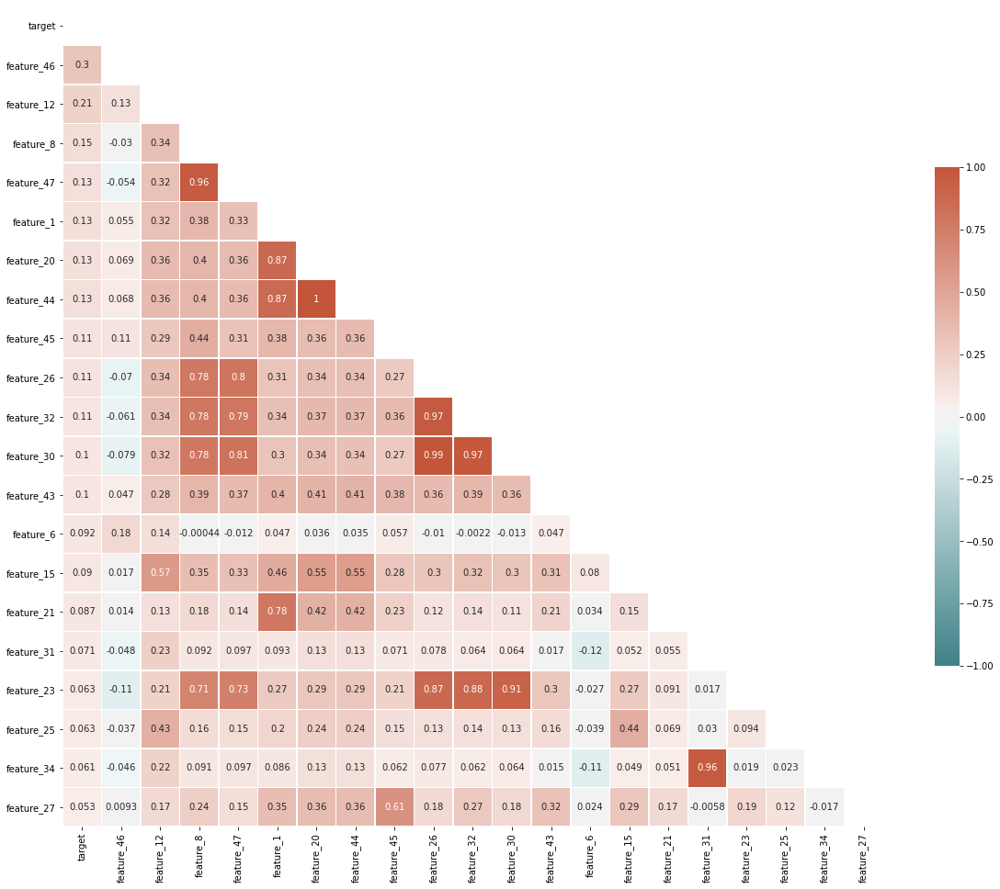

In [164]:
correlation = Xy[['target']+best_features_20].corr()

mask = np.zeros_like(correlation, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

f, ax = plt.subplots(figsize=(20, 20))

cmap = sns.diverging_palette(200, 20, as_cmap=True)
sns.heatmap(correlation, mask=mask, cmap=cmap, vmax=1, vmin=-1, center=0, square=True, linewidths=.5,cbar_kws={'shrink': .5}, annot=True)

## Corelation matrix with all features

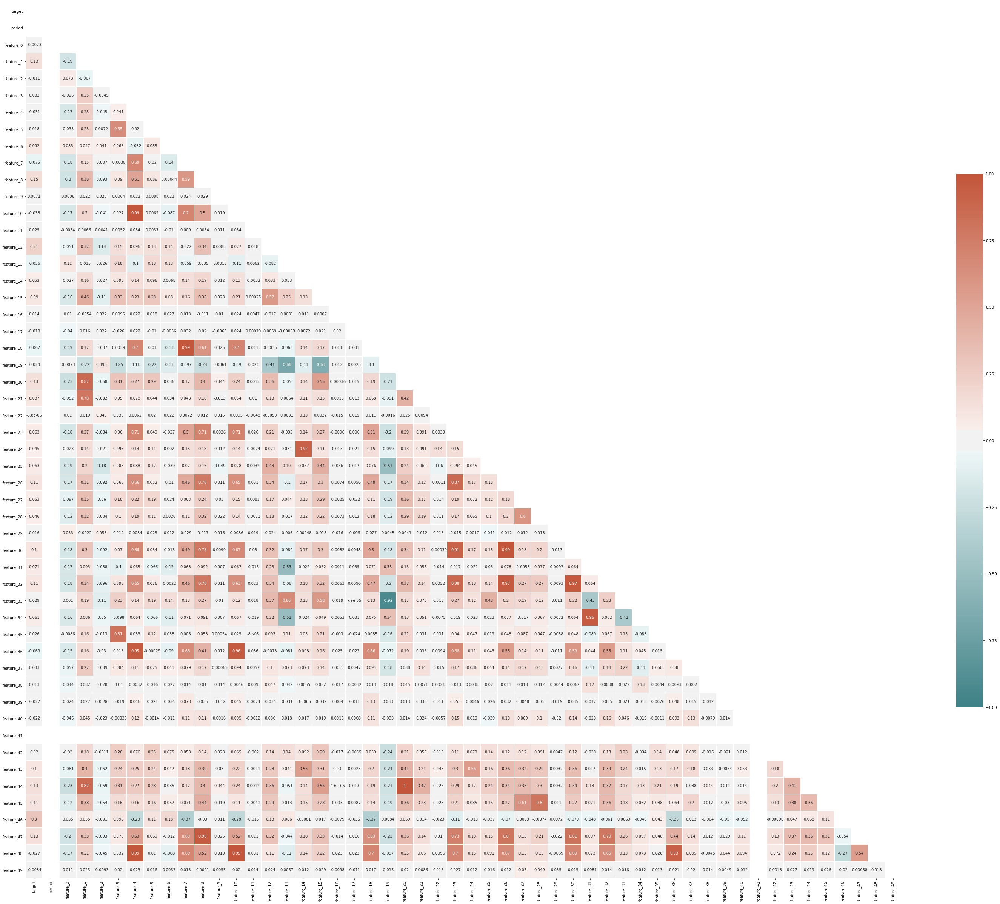

In [96]:
correlation = Xy.loc[:,'target':'feature_49'].corr()

mask = np.zeros_like(correlation, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

f, ax = plt.subplots(figsize=(52, 52))

cmap = sns.diverging_palette(200, 20, as_cmap=True)
sns.heatmap(correlation, mask=mask, cmap=cmap, vmax=1, vmin=-1, center=0, square=True, linewidths=.5,cbar_kws={'shrink': .5}, annot=True)

plt.savefig('correlation.jpg')
plt.show()

Chose features which |correlation with 'target'|  > 0.05

In [102]:
Xy_feature_15 = Xy[['id', 'target'] + best_features_15 + category_features]
test_feature_15 = Test[['id'] + best_features_15 + category_features]

Xy_feature_20 = Xy[['id', 'target'] + best_features_20 + category_features]
test_feature_20 = Test[['id'] + best_features_20 + category_features]
 
Xy_feature_25 = Xy[['id', 'target'] + best_features_25 + category_features] 
test_feature_25 = Test[['id'] + best_features_25 + category_features]

Xy_feature_30 = Xy[['id', 'target'] + best_features_30 + category_features]
test_feature_30 = Test[['id'] + best_features_30 + category_features]

In [103]:
test_feature_15.to_csv('prepared_data/test_best_features_15.csv', index=False)
Xy_feature_15.to_csv('prepared_data/train_best_features_15.csv', index=False)

test_feature_20.to_csv('prepared_data/test_best_features_20.csv', index=False)
Xy_feature_20.to_csv('prepared_data/train_best_features_20.csv', index=False)

test_feature_25.to_csv('prepared_data/test_best_features_25.csv', index=False)
Xy_feature_25.to_csv('prepared_data/train_best_features_25.csv', index=False)

test_feature_30.to_csv('prepared_data/test_best_features_30.csv', index=False)
Xy_feature_30.to_csv('prepared_data/train_best_features_30.csv', index=False)

# Choosing the best count of features

## Training model for 15 best featrues

### Spliting the data 

In [24]:
test_features_15 = pd.read_csv('prepared_data/test_best_features_15.csv')
Xy_features_15 = pd.read_csv('prepared_data/train_best_features_15.csv')

y = Xy_features_15['target']
X = Xy_features_15.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent)

print(f'train_shape:\t{X_train.shape}')
print(f'test_shape:\t{X_test.shape}')

train_shape:	(3675, 5026)
test_shape:	(409, 5026)


### Choosing the best model

In [25]:
models = []
models.append(('LR', LogisticRegression()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('DecTree', DecisionTreeClassifier())) 
models.append(('RF', RandomForestClassifier())) 
models.append(('XGB', XGBClassifier()))
models.append(('GaussianNB', GaussianNB()))
models.append(('ada', AdaBoostClassifier()))
models.append(('SVC', SVC()))

model_names = [name[0] for i,name in enumerate(models)]

In [26]:
results = get_score_for_model()

LR: 0.6324636377380678 (0.03244727878652039)
KNN: 0.5101152860601434 (0.02410882471335149)
DecTree: 0.58638663117794 (0.018340229194616565)
RF: 0.7192777076162069 (0.02356741243239615)
XGB: 0.7263136935149579 (0.03048455248689518)
GaussianNB: 0.5953614911844379 (0.03219960722013581)
ada: 0.7136457323872671 (0.029188651170444724)


KeyboardInterrupt: 

In [ ]:
df_15 = scores_features(model_names, 15, results.mean(axis=1))
df_15

# Training model for 20 best featrues


### Spliting the data

In [ ]:
test_features_20 = pd.read_csv('prepared_data/test_best_features_20.csv')
Xy_features_20 = pd.read_csv('prepared_data/train_best_features_20.csv')

y = Xy_features_20['target']
X = Xy_features_20.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent)

print(f'train_shape:\t{X_train.shape}')
print(f'test_shape:\t{X_test.shape}')

### Choosing the best model

In [ ]:
main_scores = pd.DataFrame()

In [ ]:
models = []
models.append(('LR', LogisticRegression()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('DecTree', DecisionTreeClassifier())) 
models.append(('RF', RandomForestClassifier())) 
models.append(('XGB', XGBClassifier()))
models.append(('GaussianNB', GaussianNB()))
models.append(('ada', AdaBoostClassifier()))
models.append(('SVC', SVC()))

In [ ]:
results = get_score_for_model()

df_20 = scores_features(model_names, 20, results.mean(axis=1))
main_scores = pd.merge(df_15, df_20)

## Training model for 25 best featrues

In [ ]:
test_features_25 = pd.read_csv('prepared_data/test_best_features_25.csv')
Xy_features_25 = pd.read_csv('prepared_data/train_best_features_25.csv')

y = Xy_features_25['target']
X = Xy_features_25.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent)

print(f'train_shape:\t{X_train.shape}')
print(f'test_shape:\t{X_test.shape}')

In [ ]:
models = []
models.append(('LR', LogisticRegression()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('DecTree', DecisionTreeClassifier())) 
models.append(('RF', RandomForestClassifier())) 
models.append(('XGB', XGBClassifier()))
models.append(('GaussianNB', GaussianNB()))
models.append(('ada', AdaBoostClassifier()))
models.append(('SVC', SVC()))

In [ ]:
results = get_score_for_model()

In [ ]:
df_25 = scores_features(model_names, 25, results.mean(axis=1))
main_scores = pd.merge(main_scores, df_25)

## Training model for 30 best featrues

In [ ]:
test_features_30 = pd.read_csv('prepared_data/test_best_features_30.csv')
Xy_features_30 = pd.read_csv('prepared_data/train_best_features_30.csv')

y = Xy_features_30['target']
X = Xy_features_30.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent)

print(f'train_shape:\t{X_train.shape}')
print(f'test_shape:\t{X_test.shape}')

In [ ]:
models = []
models.append(('LR', LogisticRegression()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('DecTree', DecisionTreeClassifier())) 
models.append(('RF', RandomForestClassifier())) 
models.append(('XGB', XGBClassifier()))
models.append(('GaussianNB', GaussianNB()))
models.append(('ada', AdaBoostClassifier()))
models.append(('SVC', SVC()))

In [ ]:
results = get_score_for_model()

In [ ]:
df_30 = scores_features(model_names, 30, results.mean(axis=1))
main_scores = pd.merge(main_scores, df_30)

In [ ]:
main_scores

In [144]:
main_scores.to_csv('scores/scores_features.csv')

We can see that the best result is 30 features. With algorithms **RandomForest, XGBoost, ADA, SVC**  

## Deleting some features

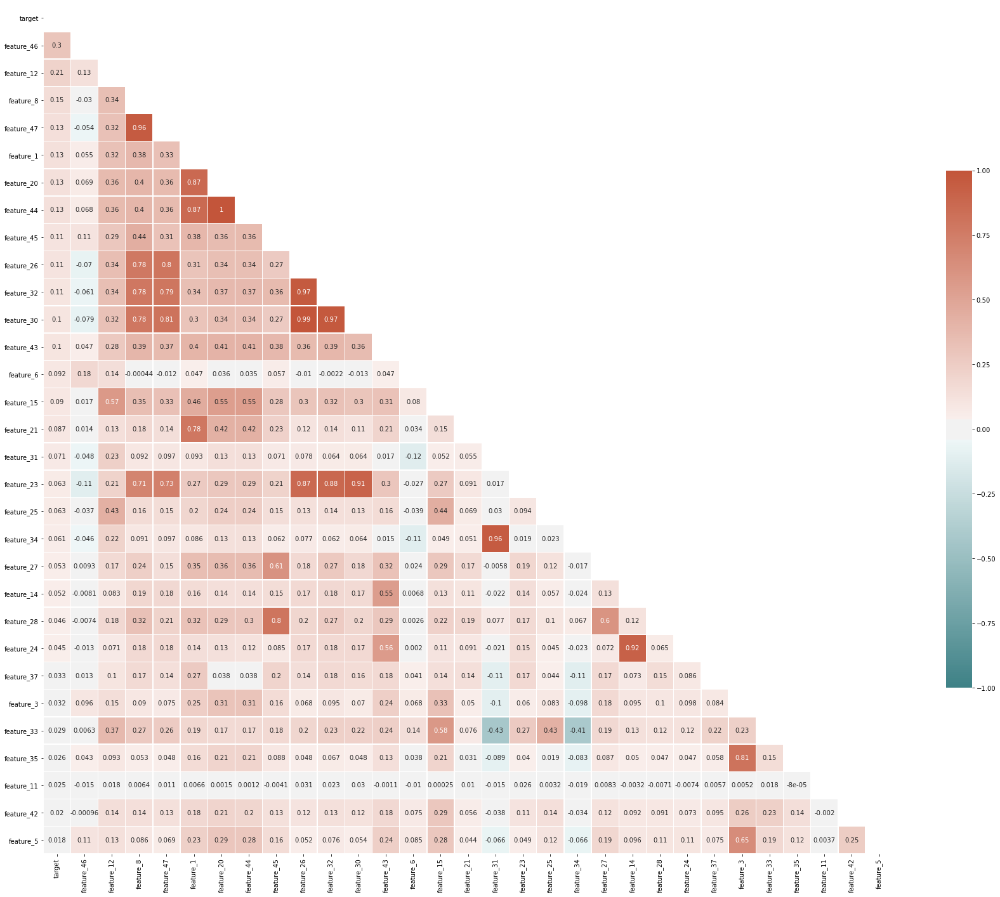

In [15]:
correlation = Xy[['target']+best_features_30].corr()

mask = np.zeros_like(correlation, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

f, ax = plt.subplots(figsize=(30, 30))

cmap = sns.diverging_palette(200, 20, as_cmap=True)
sns.heatmap(correlation, mask=mask, cmap=cmap, vmax=1, vmin=-1, center=0, square=True, linewidths=.5,cbar_kws={'shrink': .5}, annot=True)

plt.savefig('main_30_features_corelation.jpg')
plt.show()

In [18]:
best_features_15_new = ['feature_46', 'feature_12', 'feature_8','feature_47', 'feature_1',
                 'feature_45', 'feature_26', 'feature_43',
                'feature_6', 'feature_15', 'feature_21']

best_features_20_new = best_features_15_new + ['feature_31', 'feature_23', 'feature_25', 'feature_27'] 
best_features_25_new = best_features_20_new + ['feature_14','feature_37', 'feature_3'] 
best_features_30_new = best_features_25_new + ['feature_33','feature_11','feature_42','feature_5']

In [20]:
len(best_features_30_new)

22

In [19]:
Xy_feature_30_new = Xy[['id', 'target'] + best_features_30_new + category_features]
test_feature_15_new = Test[['id'] + best_features_30_new + category_features]

test_feature_15_new.to_csv('prepared_data/test_best_features_15_new.csv', index=False)
Xy_feature_30_new.to_csv('prepared_data/train_best_features_15_new.csv', index=False)

## Checking on 22 features

In [27]:
test_features_22 = pd.read_csv('prepared_data/test_best_features_15_new.csv')
Xy_features_22 = pd.read_csv('prepared_data/train_best_features_15_new.csv')

y = Xy_features_22['target']
X = Xy_features_22.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent)

print(f'train_shape:\t{X_train.shape}')
print(f'test_shape:\t{X_test.shape}')

train_shape:	(3675, 5033)
test_shape:	(409, 5033)


In [28]:
models = []
models.append(('LR', LogisticRegression()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('DecTree', DecisionTreeClassifier())) 
models.append(('RF', RandomForestClassifier())) 
models.append(('XGB', XGBClassifier()))
models.append(('GaussianNB', GaussianNB()))
models.append(('ada', AdaBoostClassifier()))
models.append(('SVC', SVC()))

In [29]:
results = get_score_for_model()

LR: 0.6427732865378306 (0.03953807481228932)
KNN: 0.5086667254830906 (0.03293862836644589)
DecTree: 0.5803752112596516 (0.03611047130156888)
RF: 0.7107663919475298 (0.02781227022714521)
XGB: 0.7157969881332868 (0.03176478747307927)
GaussianNB: 0.6038540602496985 (0.018975035895890762)
ada: 0.709732859498102 (0.028267745402026083)
SVC: 0.6936507377241525 (0.03405260757136215)


In [31]:
main_scores = pd.read_csv('scores/scores_features.csv')

In [32]:
df_22 = scores_features(model_names, 22, results.mean(axis=1))
main_scores = pd.merge(main_scores, df_22)

In [33]:
main_scores

,Unnamed: 0,names,features_15,features_20,features_25,features_30,features_22
0,0,LR,0.649612,0.636584,0.635830,0.645964,0.642773
1,1,KNN,0.503336,0.506606,0.513793,0.518229,0.508667
2,2,DecTree,0.591809,0.583345,0.566975,0.577735,0.580375
3,3,RF,0.714367,0.710812,0.708152,0.714574,0.710766
4,4,XGB,0.731700,0.705678,0.709759,0.716014,0.715797
5,5,GaussianNB,0.589228,0.587925,0.591561,0.587931,0.603854
6,6,ada,0.723473,0.706694,0.693081,0.706213,0.709733
7,7,SVC,0.681406,0.684758,0.683215,0.699096,0.693651


## Fitting the best models : RandomForest, XGBoost, ADA, SVC

In [ ]:
test_features_30 = pd.read_csv('prepared_data/test_best_features_30.csv')
Xy_features_30 = pd.read_csv('prepared_data/train_best_features_30.csv')

y = Xy_features_30['target']
X = Xy_features_30.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent)

### Random Forest fitting

In [65]:
%%time
randomForest = RandomForestClassifier()

grid2 = { 
    'n_estimators': [50,60,65,70],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth' : [25,30,35],
    'criterion' :['gini', 'entropy']
}

scoring = 'roc_auc'
clf2 = GridSearchCV(randomForest, grid2, n_jobs=-1, 
                   cv=StratifiedKFold(n_splits=10, shuffle=True), 
                   scoring='roc_auc',
                   verbose=2, refit=True)

clf2.fit(X_train, y_train)

Fitting 10 folds for each of 72 candidates, totalling 720 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:   28.9s
[Parallel(n_jobs=-1)]: Done 341 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 624 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done 720 out of 720 | elapsed:  2.7min finished


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
             estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [25, 30, 35],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [50, 60, 65, 70]},
             scoring='roc_auc', verbose=2)

In [66]:
print('best_parametrs:')
clf2.best_params_

best_parametrs:


{'criterion': 'entropy',
 'max_depth': 35,
 'max_features': 'auto',
 'n_estimators': 60}

In [68]:
name = 'RandomForest'
pred_test = clf2.predict(X_test)
pred_train = clf2.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

In [69]:
metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,RandomForest_train,0.906419,0.822927,0.645854,1.000000,0.645854
0,RandomForest_test,0.751220,0.523871,0.047742,0.444444,0.080000


In [70]:
confusion_matrix(y_train, pred_train)

array([[2854,    0],
       [ 363,  662]])

In [71]:
confusion_matrix(y_test, pred_test)

array([[150,   5],
       [ 46,   4]])

In [72]:
filename = 'models/random_forest_grid.sav'
pickle.dump(clf, open(filename, 'wb'))

## ADA

In [81]:
%%time
ada = AdaBoostClassifier()

grid = { #'base_estimator' : [None],
       'n_estimators':[80,90,100,120],
        'learning_rate': [0.2]
        #'algorithm': ['SAMME', 'SAMME.R']
       }

clf = GridSearchCV(ada, grid, n_jobs=-1,
                  cv=StratifiedKFold(n_splits=10, shuffle=True),
                  scoring='roc_auc',
                  verbose=2, refit=True)
clf.fit(X_train, y_train)

Fitting 10 folds for each of 4 candidates, totalling 40 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done  38 out of  40 | elapsed:  2.2min remaining:    6.9s
[Parallel(n_jobs=-1)]: Done  40 out of  40 | elapsed:  2.2min finished


CPU times: user 7.88 s, sys: 937 ms, total: 8.82 s
Wall time: 2min 19s


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
             estimator=AdaBoostClassifier(), n_jobs=-1,
             param_grid={'learning_rate': [0.2],
                         'n_estimators': [80, 90, 100, 120]},
             scoring='roc_auc', verbose=2)

In [82]:
print('best_parametrs:')
clf.best_params_

best_parametrs:


{'learning_rate': 0.2, 'n_estimators': 80}

In [83]:
name = 'Ada'
pred_test = clf.predict(X_test)
pred_train = clf.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

In [84]:
metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,Ada_train,0.783965,0.622793,0.245587,0.740360,0.280976
0,Ada_test,0.770732,0.584194,0.168387,0.578947,0.220000


In [25]:
confusion_matrix(y_train, pred_train)

array([[2321,   88],
       [ 650,  208]])

In [26]:
confusion_matrix(y_test, pred_test)

array([[581,  19],
       [158,  59]])

In [27]:
filename = 'models/ada_80_grid.sav'
pickle.dump(clf, open(filename, 'wb'))

## SVM

In [22]:
%%time
svm = SVC()

grid = { 'C':[1],
        'kernel': ['linear', 'rbf'],
        'degree' :[1],
        'gamma': ['scale'],
        'tol' : [1e-3],
        'decision_function_shape': ['ovo'],
        'cache_size' :[200]
       }

clf = GridSearchCV(svm, grid, n_jobs=-1,
                  cv=StratifiedKFold(n_splits=3, shuffle=True),
                  scoring='roc_auc',
                  verbose=2, refit=True)
clf.fit(X_train, y_train)

Fitting 10 folds for each of 2 candidates, totalling 20 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 out of  20 | elapsed:  3.8min remaining:  5.8min
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed: 18.2min finished


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
             estimator=SVC(), n_jobs=-1,
             param_grid={'C': [1], 'cache_size': [200],
                         'decision_function_shape': ['ovo'], 'degree': [1],
                         'gamma': ['scale'], 'kernel': ['linear', 'rbf'],
                         'tol': [0.001]},
             scoring='roc_auc', verbose=2)

In [23]:
print('best_parametrs:')
clf.best_params_

best_parametrs:


{'C': 1,
 'cache_size': 200,
 'decision_function_shape': 'ovo',
 'degree': 1,
 'gamma': 'scale',
 'kernel': 'rbf',
 'tol': 0.001}

In [28]:
name = 'SVC'
pred_test = clf.predict(X_test)
pred_train = clf.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

/home/eduard/anaconda3/envs/ml_coursera/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1221: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [29]:
metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,SVC_train,0.728191,0.5,0.0,0.0,0.0
0,SVC_test,0.771114,0.5,0.0,0.0,0.0


In [30]:
confusion_matrix(y_train, pred_train)

array([[2379,    0],
       [ 888,    0]])

In [31]:
confusion_matrix(y_test, pred_test)

array([[630,   0],
       [187,   0]])

## Training models with found parametrs

In [5]:
test_features_30 = pd.read_csv('prepared_data/test_best_features_30.csv')
Xy_features_30 = pd.read_csv('prepared_data/train_best_features_30.csv')

y = Xy_features_30['target']
X = Xy_features_30.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent)

In [7]:
ada_best = AdaBoostClassifier(learning_rate=0.2,
                              n_estimators=80)

randomForest_best = RandomForestClassifier(criterion='entropy',
                                         max_depth=35,
                                         max_features='auto',
                                         n_estimators=60)

In [8]:
%%time
ada_best = ada_best.fit(X_train, y_train)

CPU times: user 7.32 s, sys: 929 ms, total: 8.25 s
Wall time: 8.25 s


In [9]:
%%time
randomForest_best = randomForest_best.fit(X_train, y_train)

CPU times: user 1.4 s, sys: 12 ms, total: 1.41 s
Wall time: 1.41 s


In [11]:
filename = 'models/ada_best.sav'
pickle.dump(ada_best, open(filename, 'wb'))

filename = 'models/randomForest_best.sav'
pickle.dump(randomForest_best, open(filename, 'wb'))

## Calcuate metrics

In [116]:
name = 'RandomForst_best'
pred_test = randomForest_best.predict(X_test)
pred_train = randomForest_best.predict(X_train)

metric_train_rf, metric_test_rf = define_metrics(pred_train, pred_test, y_train,y_test, name)

In [160]:
name = 'ada_best'
pred_test = ada_best.predict(X_test)
pred_train = ada_best.predict(X_train)

metric_train_ada, metric_test_ada = define_metrics(pred_train, pred_test, y_train,y_test, name)

NameError: name 'ada_best' is not defined

In [159]:
confusion_matrix(y_train, pred_train)

NameError: name 'pred_train' is not defined

In [118]:
metric_train_rf.append(metric_train_ada).append(metric_test_rf).append(metric_test_ada)

,name,accuracy,auc,gini,precision,recall
0,RandomForst_best_train,0.911565,0.835859,0.671717,1.000000,0.671717
0,ada_best_train,0.777687,0.621807,0.243615,0.722365,0.283838
0,RandomForst_best_test,0.782396,0.550236,0.100472,0.433333,0.152941
0,ada_best_test,0.789731,0.585240,0.170479,0.487805,0.235294


## Choosing cut-off

In [156]:
def predict_threashold(model, x_train, threashold):
    pred_train = model.predict_proba(x_train)
    pred_train_1 = np.array([i[0] for i in pred_train])
    pred_res_train = np.where(pred_train_1 > threashold, 0, 1)
    
    return pred_res_train

In [139]:
def trade_cut_off(model, x_train, y_train, x_test, y_test, name_base, start_th, end_th, num):
    columns = ['name', 'accuracy', 'auc','gini', 'precision', 'recall']
    trades = np.linspace(start_th, end_th, num=num, retstep=False)
    metrics_train = pd.DataFrame(columns=columns)
    metrics_test = pd.DataFrame(columns=columns)
    
    pred_test = model.predict_proba(x_test)
    pred_train = model.predict_proba(x_train)
    
    pred_test_1 = np.array([i[0] for i in pred_test])
    pred_train_1 = np.array([i[0] for i in pred_train])
    
    name = f'{name_base}_cut'
    
    for treashold in trades:
        
 
        pred_res_train = np.where(pred_train_1 > treashold, 0, 1)
        pred_res_test = np.where(pred_test_1 > treashold, 0, 1)
        
        metric_train, metric_test = define_metrics(pred_res_train, pred_res_test, y_train,y_test, name)
        
        metrics_train = metrics_train.append(metric_train)
        metrics_test = metrics_train.append(metrics_test)
    
    df_threas = pd.DataFrame({'name':metrics_train.name, 'cut_off':trades})
    metrics_train = pd.merge(metrics_train, df_threas)
    metrics_test = pd.merge(metrics_train, df_threas)
    
    data_max = [max(metrics_train[name]) for name in columns[1:]] 
    data_min = [min(metrics_train[name]) for name in columns[1:]] 
    data = np.array([data_max, data_min]).T
    
    df_max = pd.DataFrame(data=data, index=columns[1:], columns=['max', 'min'])
    
    return metrics_train, metrics_test, df_max

In [ ]:
model = model
x_train = X_train
y_train = y_train
x_test = X_test
y_test = y_test
name_base = 'ada'
start_th = 0.4
end_th = 0.55
num = 20

metrics_train_cutt, metrics_test_cutt, trades = trade_cut_off(model, x_train, y_train, x_test, y_test, name_base, start_th, end_th, num)

In [141]:
trades

,max,min
accuracy,0.785850,0.269660
auc,0.706494,0.501391
gini,0.412987,0.002783
precision,1.000000,0.267213
recall,0.997959,0.003061


In [148]:
metrics_train_cutt[metrics_train_cutt.auc >= 0.65]

,name,accuracy,auc,gini,precision,recall,cut_off
280,ada_cut_train,0.769524,0.700974,0.401948,0.569780,0.554082,0.400000
281,ada_cut_train,0.769524,0.700974,0.401948,0.569780,0.554082,0.407895
282,ada_cut_train,0.769524,0.700974,0.401948,0.569780,0.554082,0.415789
283,ada_cut_train,0.769524,0.700974,0.401948,0.569780,0.554082,0.423684
284,ada_cut_train,0.769524,0.700974,0.401948,0.569780,0.554082,0.431579
285,ada_cut_train,0.769524,0.700974,0.401948,0.569780,0.554082,0.439474
286,ada_cut_train,0.769524,0.700974,0.401948,0.569780,0.554082,0.447368
287,ada_cut_train,0.769524,0.700974,0.401948,0.569780,0.554082,0.455263
288,ada_cut_train,0.769524,0.700974,0.401948,0.569780,0.554082,0.463158
289,ada_cut_train,0.769524,0.700974,0.401948,0.569780,0.554082,0.471053


In [157]:
threashold = 0.423684
x_train = X_train
model = model
prediction = predict_threashold(model, x_train, threashold)

In [158]:
confusion_matrix(y_train, prediction)

array([[2695,    0],
       [ 972,    8]])

## ensemble

In [119]:
%%time
voting_hard = VotingClassifier(estimators=[('ada', ada_best), ('randomForest', randomForest_best)], 
                       voting='hard').fit(X_train, y_train)

voting_soft = VotingClassifier(estimators=[('ada', ada_best), ('randomForest', randomForest_best)], 
                       voting='soft').fit(X_train, y_train)

CPU times: user 17.2 s, sys: 1.74 s, total: 19 s
Wall time: 19 s


###  metrics for hard and soft

In [120]:
name = 'voting_soft'
pred_test = voting_soft.predict(X_test)
pred_train = voting_soft.predict(X_train)

metric_train_soft, metric_test_soft = define_metrics(pred_train, pred_test, y_train,y_test, name)

In [121]:
name = 'voting_hard'
pred_test = voting_hard.predict(X_test)
pred_train = voting_hard.predict(X_train)

metric_train_hard, metric_test_hard = define_metrics(pred_train, pred_test, y_train,y_test, name)

In [128]:
metric_train_soft.append(metric_test_soft)

,name,accuracy,auc,gini,precision,recall
0,voting_soft_train,0.903946,0.821717,0.643434,1.000000,0.643434
0,voting_soft_test,0.816626,0.597876,0.195752,0.678571,0.223529


In [129]:
metric_train_hard.append(metric_test_hard)

,name,accuracy,auc,gini,precision,recall
0,voting_hard_train,0.802993,0.634343,0.268687,1.0,0.268687
0,voting_hard_test,0.792176,0.534713,0.069426,0.5,0.094118


In [153]:
pickle.dumpfilename = 'models/voting_soft.sav'
pickle.dump(voting_soft, open(filename, 'wb'))

Soft better

### Choosing weights

In [151]:
%%time
columns = ['name',
            'accuracy', 
          'auc',
          'gini',
          'precision',
          'recall']

metrics_test_weight = pd.DataFrame(columns=columns)
metrics_train_weight = pd.DataFrame(columns=columns)


weights = [0.2,0.3,0.4,0.5,0.6,0.7,0.8]

for weight in weights:
    weights_main = [weight, 1- weight]
    voting_soft_weight = VotingClassifier(estimators=[('ada', ada_best), ('randomForest', randomForest_best)], 
                       voting='soft', weights=weights_main, n_jobs=12).fit(X_train, y_train)
    
    name = f'voting_soft_weight_{weights_main}'
    pred_test = voting_soft_weight.predict(X_test)
    pred_train = voting_soft_weight.predict(X_train)

    metric_train_soft_weight, metric_test_soft_weight = define_metrics(pred_train, pred_test, y_train,y_test, name)
    
    metrics_train_weight = metrics_train_weight.append(metric_train_soft_weight)
    metrics_test_weight = metrics_test_weight.append(metric_test_soft_weight)

CPU times: user 14.3 s, sys: 3.34 s, total: 17.7 s
Wall time: 1min 17s


### Metrcis

In [152]:
metrics_train_weight.append(metrics_test_weight)

,name,accuracy,auc,gini,precision,recall
0,"voting_soft_weight_[0.2, 0.8]_train",0.910476,0.833838,0.667677,1.000000,0.667677
0,"voting_soft_weight_[0.3, 0.7]_train",0.900136,0.814646,0.629293,1.000000,0.629293
0,"voting_soft_weight_[0.4, 0.6]_train",0.900680,0.815657,0.631313,1.000000,0.631313
0,"voting_soft_weight_[0.5, 0.5]_train",0.899592,0.813636,0.627273,1.000000,0.627273
0,"voting_soft_weight_[0.6, 0.4]_train",0.903401,0.820707,0.641414,1.000000,0.641414
0,"voting_soft_weight_[0.7, 0.30000000000000004]_...",0.889796,0.795455,0.590909,1.000000,0.590909
0,"voting_soft_weight_[0.8, 0.19999999999999996]_...",0.881633,0.780303,0.560606,1.000000,0.560606
0,"voting_soft_weight_[0.2, 0.8]_test",0.799511,0.578395,0.156790,0.548387,0.200000
0,"voting_soft_weight_[0.3, 0.7]_test",0.797066,0.568174,0.136347,0.535714,0.176471
0,"voting_soft_weight_[0.4, 0.6]_test",0.789731,0.559205,0.118410,0.482759,0.164706


# ======================================================

# Balancing data set (deleting rows with additional target==0)

In [21]:
df_tabular = pd.read_csv("data/tabular_data.csv")
df_hashed = pd.read_csv("data/hashed_feature.csv")
df_train_target = pd.read_csv("data/train.csv")
df_test_target = pd.read_csv("data/test.csv")

In [22]:
test_features_30 = pd.read_csv('prepared_data/test_best_features_30.csv')
Xy_features_30 = pd.read_csv('prepared_data/train_best_features_30.csv')

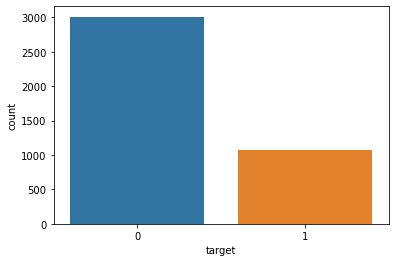

In [24]:
sns.countplot(Xy_features_30.target, label='Sum')
plt.show()

In [25]:
len_of_1 = Xy_features_30[Xy_features_30.target == 1].shape[0]
df_target_1_balanced =  Xy_features_30[Xy_features_30.target == 1]
df_target_0_balanced = Xy_features_30[Xy_features_30.target == 0].sample(n=len_of_1)
df_balanced = df_target_1_balanced.append(df_target_0_balanced)

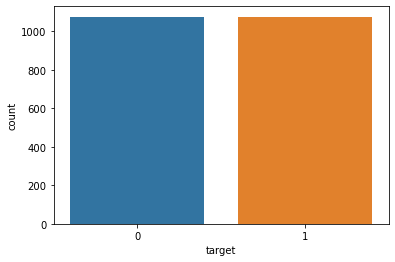

In [27]:
sns.countplot(df_balanced.target, label='Sum')
plt.show()

In [26]:
df_balanced.to_csv('prepared_data/train_best_features_30_balanced.csv', index=False)

## Choosing models

In [3]:
df_balanced = pd.read_csv('prepared_data/train_best_features_30_balanced.csv')
y = df_balanced['target']
X = df_balanced.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent)

print(f'train_shape:\t{X_train.shape}')
print(f'test_shape:\t{X_test.shape}')

train_shape:	(1827, 5041)
test_shape:	(323, 5041)


In [24]:
%%time
models = []
models.append(('LR', LogisticRegression()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('DecTree', DecisionTreeClassifier())) 
models.append(('RF', RandomForestClassifier())) 
models.append(('XGB', XGBClassifier()))
models.append(('GaussianNB', GaussianNB()))
models.append(('ada', AdaBoostClassifier()))
models.append(('SVC', SVC()))

model_names = [name[0] for i,name in enumerate(models)]

results = get_score_for_model()

LR: 0.6203538116277438 (0.039374131780909816)
KNN: 0.49641741291718083 (0.03226254122656023)
DecTree: 0.6009804114944947 (0.028267490245966035)
RF: 0.7089079325600471 (0.03605468648788058)
XGB: 0.7162516366946396 (0.0466329776414616)
GaussianNB: 0.6034622474375021 (0.022551711942822416)
ada: 0.690479397665645 (0.06021848787276031)
SVC: 0.5029564186446179 (0.026740087028883894)
CPU times: user 519 ms, sys: 329 ms, total: 848 ms
Wall time: 1min 58s


## Random Forest

In [42]:
%%time
randomForest = RandomForestClassifier()

grid2 = { 
    'n_estimators': [35,40,45, 50, 55,60],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth' : [20, 25,30,35,40,45],
    'criterion' :['gini', 'entropy']
}

scoring = 'roc_auc'
clf2 = GridSearchCV(randomForest, grid2, n_jobs=-1, 
                   cv=StratifiedKFold(n_splits=10, shuffle=True), 
                   scoring='roc_auc',
                   verbose=2, refit=True)

clf2.fit(X_train, y_train)

Fitting 10 folds for each of 216 candidates, totalling 2160 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:   13.4s
[Parallel(n_jobs=-1)]: Done 341 tasks      | elapsed:   31.4s
[Parallel(n_jobs=-1)]: Done 624 tasks      | elapsed:  1.0min
[Parallel(n_jobs=-1)]: Done 989 tasks      | elapsed:  1.8min
[Parallel(n_jobs=-1)]: Done 1434 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done 1961 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done 2160 out of 2160 | elapsed:  3.8min finished


CPU times: user 14.8 s, sys: 461 ms, total: 15.3 s
Wall time: 3min 47s


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
             estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [20, 25, 30, 35, 40, 45],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [35, 40, 45, 50, 55, 60]},
             scoring='roc_auc', verbose=2)

In [43]:
clf2.best_params_

{'criterion': 'entropy',
 'max_depth': 25,
 'max_features': 'sqrt',
 'n_estimators': 45}

In [44]:
name = 'RandomForest'
pred_test = clf2.predict(X_test)
pred_train = clf2.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

In [45]:
metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,RandomForest_train,0.917313,0.916941,0.833881,0.996292,0.836968
0,RandomForest_test,0.627907,0.630374,0.260749,0.666667,0.571429


In [46]:
confusion_matrix(y_train, pred_train)

array([[969,   3],
       [157, 806]])

In [47]:
confusion_matrix(y_test, pred_test)

array([[71, 32],
       [48, 64]])

## ADA

In [12]:
%%time
ada = AdaBoostClassifier()

grid = { #'base_estimator' : [None],
       'n_estimators':[40,45,50,55],
        'learning_rate': [0.5,0.6,0.7]
       }

clf = GridSearchCV(ada, grid, n_jobs=-1,
                  cv=StratifiedKFold(n_splits=10, shuffle=True),
                  scoring='roc_auc',
                  verbose=2, refit=True)
clf.fit(X_train, y_train)

Fitting 10 folds for each of 12 candidates, totalling 120 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:   15.0s
[Parallel(n_jobs=-1)]: Done 120 out of 120 | elapsed:  1.4min finished


CPU times: user 3.02 s, sys: 339 ms, total: 3.36 s
Wall time: 1min 27s


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
             estimator=AdaBoostClassifier(), n_jobs=-1,
             param_grid={'learning_rate': [0.5, 0.6, 0.7],
                         'n_estimators': [40, 45, 50, 55]},
             scoring='roc_auc', verbose=2)

In [11]:
print(clf.best_params_)

name = 'ada'
pred_test = clf.predict(X_test)
pred_train = clf.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

{'learning_rate': 0.7, 'n_estimators': 50}


,name,accuracy,auc,gini,precision,recall
0,ada_train,0.754242,0.754745,0.509490,0.77752,0.723060
0,ada_test,0.696594,0.694689,0.389378,0.66443,0.673469


## Train model separately

In [28]:
df_balanced = pd.read_csv('prepared_data/train_best_features_30_balanced.csv')
y = df_balanced['target']
X = df_balanced.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent)

print(f'train_shape:\t{X_train.shape}')
print(f'test_shape:\t{X_test.shape}')

train_shape:	(1827, 5041)
test_shape:	(323, 5041)


In [14]:
ada_best = AdaBoostClassifier(learning_rate=0.7,
                              n_estimators=50)

randomForest_best = RandomForestClassifier(criterion='entropy',
                                         max_depth=25,
                                         max_features='sqrt',
                                         n_estimators=45)

In [15]:
%%time
ada_best = ada_best.fit(X_train, y_train)

CPU times: user 2.38 s, sys: 255 ms, total: 2.63 s
Wall time: 2.63 s


In [20]:
%%time
randomForest_best = randomForest_best.fit(X_train, y_train)

CPU times: user 435 ms, sys: 0 ns, total: 435 ms
Wall time: 434 ms


In [16]:
filename = 'models/ada_best_balanced_delete.sav'
pickle.dump(ada_best, open(filename, 'wb'))

In [92]:
filename = 'models/random_forest_best_balanced_delete.sav'
pickle.dump(randomForest_best, open(filename, 'wb'))

In [75]:
# Read models
filename = 'models/ada_best_balanced_delete.sav'
ada_best = pickle.load(open(filename, 'rb'))

filename = 'models/random_forest_best_balanced_delete.sav'
randomForest_best = pickle.load(open(filename, 'rb'))

In [17]:
name = 'ada'
pred_test = ada_best.predict(X_test)
pred_train = ada_best.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,ada_train,0.754242,0.754745,0.509490,0.77752,0.723060
0,ada_test,0.696594,0.694689,0.389378,0.66443,0.673469


In [21]:
name = 'Random_Forest'
pred_test = randomForest_best.predict(X_test)
pred_train = randomForest_best.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,Random_Forest_train,0.928845,0.929922,0.859844,0.997506,0.862069
0,Random_Forest_test,0.668731,0.661275,0.322549,0.653846,0.578231


## Ensemble

In [18]:
from sklearn.ensemble import VotingClassifier

clf1 = AdaBoostClassifier(learning_rate=0.7,
                              n_estimators=50)

clf2 = RandomForestClassifier(criterion='entropy',
                                         max_depth=25,
                                         max_features='sqrt',
                                         n_estimators=45)
# not train model previosly
ensemble=VotingClassifier(estimators=[('Clf1', clf1), ('Clf2', clf2),], 
                       voting='soft').fit(X_train, y_train)

In [19]:
name='ensemble_1'
pred_test = ensemble.predict(X_test)
pred_train = ensemble.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,ensemble_1_train,0.921182,0.922362,0.844723,0.996203,0.848060
0,ensemble_1_test,0.668731,0.664077,0.328154,0.642857,0.612245


In [38]:
# train model previosly
ensemble2=VotingClassifier(estimators=[('Clf1', ada_best), ('Clf2', randomForest_best),], 
                       voting='soft').fit(X_train, y_train)

In [39]:
name='ensemble_2'
pred_test = ensemble2.predict(X_test)
pred_train = ensemble2.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,ensemble_2_train,0.927750,0.928896,0.857792,0.984262,0.872318
0,ensemble_2_test,0.647059,0.640210,0.280420,0.605839,0.580420


if does not train model previosly we will get better result 

# ==================================================

# Balancing data uses with dublicates

In [3]:
test_features_30 = pd.read_csv('prepared_data/test_best_features_30.csv')
Xy_features_30 = pd.read_csv('prepared_data/train_best_features_30.csv')

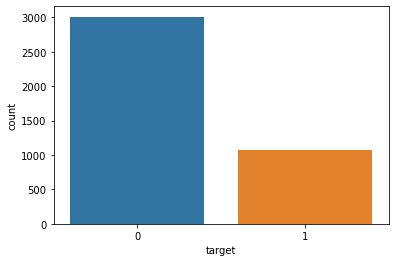

In [4]:
sns.countplot(Xy_features_30.target, label='Sum')
plt.show()

In [5]:
len_of_1 = Xy_features_30[Xy_features_30.target == 0].shape[0]
df_target_0_balanced =  Xy_features_30[Xy_features_30.target == 0]
df_target_1_balanced = Xy_features_30[Xy_features_30.target ==1].sample(n=len_of_1, replace=True)
df_balanced = df_target_1_balanced.append(df_target_0_balanced)

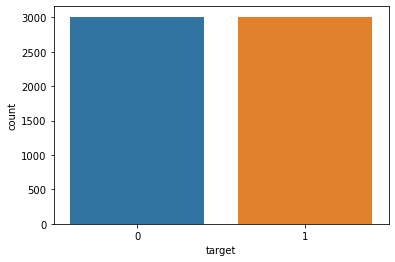

In [6]:
sns.countplot(df_balanced.target, label='Sum')
plt.show()

In [6]:
df_balanced.to_csv('prepared_data/train_best_features_30_balanced_addition.csv')

## Choosing models 

In [7]:
df_balanced = pd.read_csv('prepared_data/train_best_features_30_balanced_addition.csv')
y = df_balanced['target']
X = df_balanced.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent)

print(f'train_shape:\t{X_train.shape}')
print(f'test_shape:\t{X_test.shape}')

train_shape:	(5115, 5042)
test_shape:	(903, 5042)


In [54]:
%%time
models = []
models.append(('LR', LogisticRegression()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('DecTree', DecisionTreeClassifier())) 
models.append(('RF', RandomForestClassifier())) 
models.append(('XGB', XGBClassifier()))
models.append(('GaussianNB', GaussianNB()))
models.append(('ada', AdaBoostClassifier()))
models.append(('SVC', SVC()))

model_names = [name[0] for i,name in enumerate(models)]

results = get_score_for_model()

LR: 0.8557900214031813 (0.022378989615277043)
KNN: 0.791005634358166 (0.018928075840166262)
DecTree: 0.8430481149597963 (0.017604830421524713)
RF: 0.9692490958916885 (0.009335908538097118)
XGB: 0.9346698292059632 (0.014609448383199235)
GaussianNB: 0.6955177470562929 (0.026434324294439544)
ada: 0.7726331297564293 (0.012016826882632498)
SVC: 0.5247236885501467 (0.02972708418999446)
CPU times: user 570 ms, sys: 681 ms, total: 1.25 s
Wall time: 8min 28s


## Random Forest 

In [9]:
%%time
randomForest = RandomForestClassifier()

grid2 = { 
    'n_estimators': [30,40,50,60],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth' : [25,30,40],
    'criterion' :['gini', 'entropy'],
    'class_weight' : ['balanced']
}

scoring = 'roc_auc'
clf2 = GridSearchCV(randomForest, grid2, n_jobs=-1, 
                   cv=StratifiedKFold(n_splits=10, shuffle=True), 
                   scoring='roc_auc',
                   verbose=2, refit=True)

clf2.fit(X_train, y_train)

Fitting 10 folds for each of 72 candidates, totalling 720 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:   12.0s
[Parallel(n_jobs=-1)]: Done 341 tasks      | elapsed:   32.8s
[Parallel(n_jobs=-1)]: Done 624 tasks      | elapsed:   57.7s
[Parallel(n_jobs=-1)]: Done 720 out of 720 | elapsed:  1.1min finished


CPU times: user 5.01 s, sys: 157 ms, total: 5.17 s
Wall time: 1min 7s


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
             estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'class_weight': ['balanced'],
                         'criterion': ['gini', 'entropy'],
                         'max_depth': [25, 30, 40],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [30, 40, 50, 60]},
             scoring='roc_auc', verbose=2)

In [13]:
print(clf2.best_params_)

name='Random Forest'
pred_test = clf2.predict(X_test)
pred_train = clf2.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

{'criterion': 'entropy', 'max_depth': 40, 'max_features': 'sqrt', 'n_estimators': 60}


,name,accuracy,auc,gini,precision,recall
0,Random Forest_train,0.985222,0.985304,0.970607,0.998881,0.971708
0,Random Forest_test,0.674923,0.674440,0.348879,0.664516,0.660256


## ADA

In [11]:
%%time
ada = AdaBoostClassifier()

grid = { 
       'n_estimators':[800,900],
        'learning_rate': [1]
       }

clf = GridSearchCV(ada, grid, n_jobs=-1,
                  cv=StratifiedKFold(n_splits=10, shuffle=True),
                  scoring='roc_auc',
                  verbose=2, refit=True)
clf.fit(X_train, y_train)

Fitting 10 folds for each of 2 candidates, totalling 20 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done   8 out of  20 | elapsed:  2.4min remaining:  3.6min
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:  4.3min finished


CPU times: user 41.1 s, sys: 4.84 s, total: 46 s
Wall time: 5min 2s


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
             estimator=AdaBoostClassifier(), n_jobs=-1,
             param_grid={'learning_rate': [1], 'n_estimators': [800, 900]},
             scoring='roc_auc', verbose=2)

In [12]:
print(clf.best_params_)

name='ada'
pred_test = clf.predict(X_test)
pred_train = clf.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

{'learning_rate': 1, 'n_estimators': 900}


,name,accuracy,auc,gini,precision,recall
0,ada_train,0.998358,0.998363,0.996726,0.997792,0.998895
0,ada_test,0.647059,0.648366,0.296732,0.679487,0.623529


## Train model separately

In [5]:
df_balanced = pd.read_csv('prepared_data/train_best_features_30_balanced.csv')
y = df_balanced['target']
X = df_balanced.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent)

print(f'train_shape:\t{X_train.shape}')
print(f'test_shape:\t{X_test.shape}')

train_shape:	(1827, 5041)
test_shape:	(323, 5041)


In [13]:
ada_best = AdaBoostClassifier(learning_rate=1,
                              n_estimators=900)

randomForest_best = RandomForestClassifier(criterion='entropy',
                                         max_depth=40,
                                         max_features='sqrt',
                                         n_estimators=60)

In [14]:
%%time
ada_best = ada_best.fit(X_train, y_train)

CPU times: user 42.4 s, sys: 5.37 s, total: 47.8 s
Wall time: 47.8 s


In [18]:
%%time
randomForest_best = randomForest_best.fit(X_train, y_train)

CPU times: user 778 ms, sys: 7.93 ms, total: 786 ms
Wall time: 788 ms


In [19]:
name='Random Forest'
pred_test = randomForest_best.predict(X_test)
pred_train = randomForest_best.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,Random Forest_train,0.997263,0.997253,0.994505,1.000000,0.994505
0,Random Forest_test,0.653251,0.654430,0.308861,0.682759,0.600000


In [15]:
name='ada'
pred_test = ada_best.predict(X_test)
pred_train = ada_best.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,ada_train,0.998358,0.998363,0.996726,0.997792,0.998895
0,ada_test,0.647059,0.648366,0.296732,0.679487,0.623529


In [14]:
filename = 'models/randomForest_best_balanced_addition.sav'
pickle.dump(randomForest_best, open(filename, 'wb'))

NameError: name 'randomForest_best' is not defined

In [16]:
filename = 'models/ada_best_balanced_addition.sav'
pickle.dump(randomForest_best, open(filename, 'wb'))

## Ensemble

In [17]:
name_model_1 = 'RandomForest'
name_model_2 = 'ada'

clf1 =  RandomForestClassifier(criterion='entropy',
                                         max_depth=40,
                                         max_features='sqrt',
                                         n_estimators=60)
clf2 = AdaBoostClassifier(learning_rate=1,
                              n_estimators=900)

ensemble2=VotingClassifier(estimators=[(name_model_1, clf1), (name_model_2, clf2)], n_jobs=-1, 
                       voting='soft', verbose=True).fit(X_train, y_train)

In [18]:
name='ensemble'
pred_test = ensemble2.predict(X_test)
pred_train = ensemble2.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,ensemble_train,0.989053,0.988950,0.977901,1.000000,0.977901
0,ensemble_test,0.678019,0.681373,0.362745,0.729167,0.617647


# ===========================================
# Working with data preparation

In [24]:
def plot_dependency_features(feature_name, df_frame, ncols=4, figsize=(24, 100), s=10, saving=None, label_name='target'):
    columns = df_frame.columns.to_numpy()[2:-1]
    index = np.where(columns == feature_name)[0][0]
    features_quantities = columns.shape[0]
    
    size_square = features_quantities - index
    
#     print(f'index:\t{index}\nsize_square:\t{size_square}')

    nrows = (size_square // ncols ) + 2
    figsize = (figsize[0], (figsize[0] // 4) * nrows)
    f, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize, sharex=False, sharey = False)
    
#     print(f'nrows:\t{nrows}:\tncols:\t{ncols}')
    i = index + 1
    i_rows_res = 0
    i_cols_res = 0
    
    for i_rows in range(nrows):
        for i_cols in range(ncols):
            if i >= features_quantities:
                break
            feature_2 = columns[i]
            axes[i_rows, i_cols].scatter(df_frame[df_frame[label_name] == 0][feature_name], 
                        df_frame[df_frame[label_name]==0][feature_2], s=s, color='red', 
                      label='False')

            axes[i_rows, i_cols].scatter(df_frame[df_frame[label_name] == 1][feature_name], 
                        df_frame[df_frame[label_name]==1][feature_2], s=s, color='blue', 
                        label='True')
            axes[i_rows, i_cols].set_title(f'dependency {feature_name} - {feature_2}')
            axes[i_rows, i_cols].set_xlabel(feature_name)
            axes[i_rows, i_cols].set_ylabel(feature_2)
            axes[i_rows, i_cols].legend()
            i += 1
            
            i_rows_res = i_rows
            i_cols_res = i_cols

#     print(f'i_cols_res:\t{i_cols_res}\ni_rows_res:\t{i_rows_res}')
    if i_cols_res <= ncols:
        i_cols_res += 1
        for i in range(i_cols_res, ncols):
            axes[i_rows_res, i].remove()
        
        i_cols_res = 0
        i_rows_res += 1

    for j in range(i_cols_res, ncols):
        for i in range(i_rows_res, nrows):
            axes[i, j].remove()
            
    if saving is not None:
        plt.savefig(saving)
        
    plt.show()

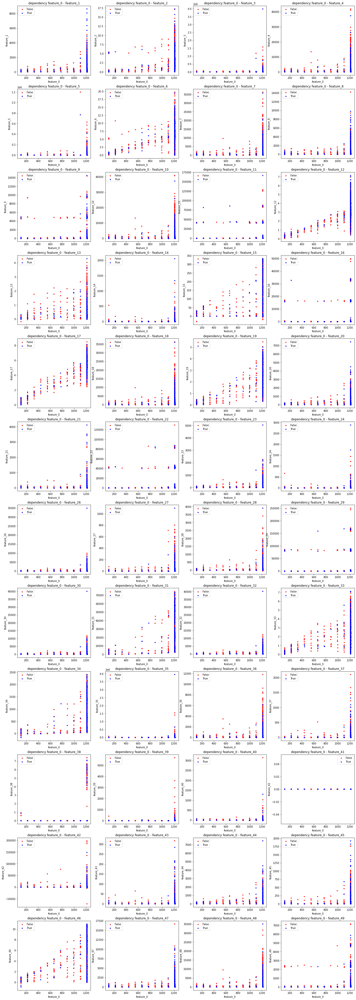

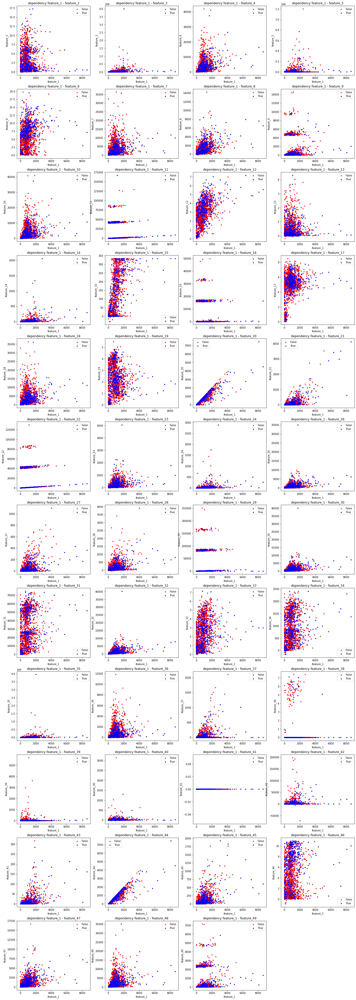

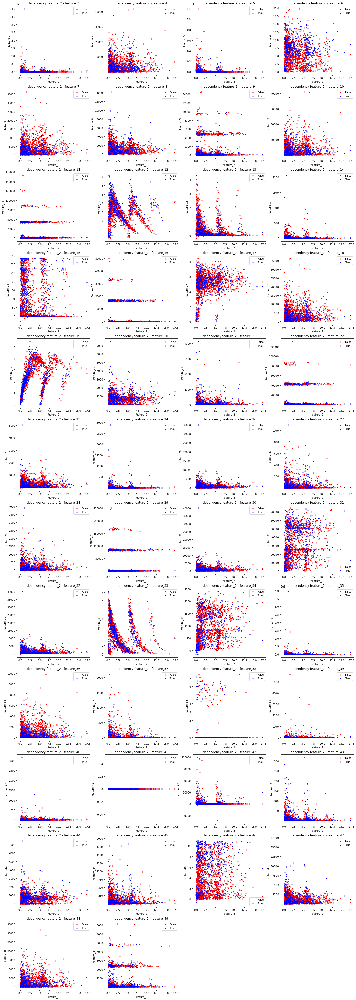

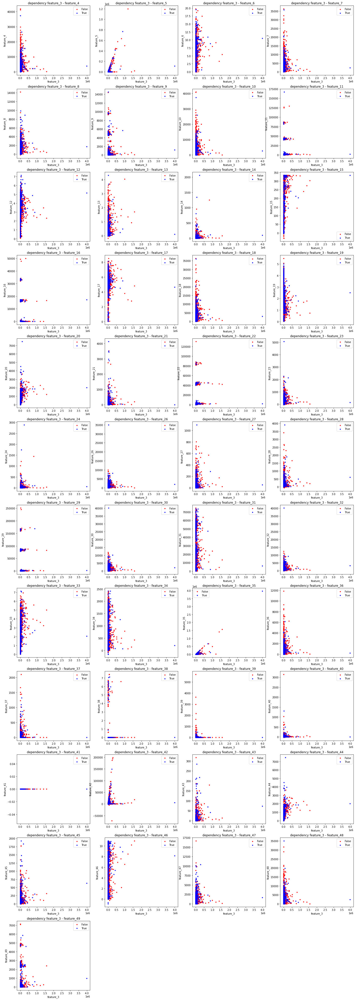

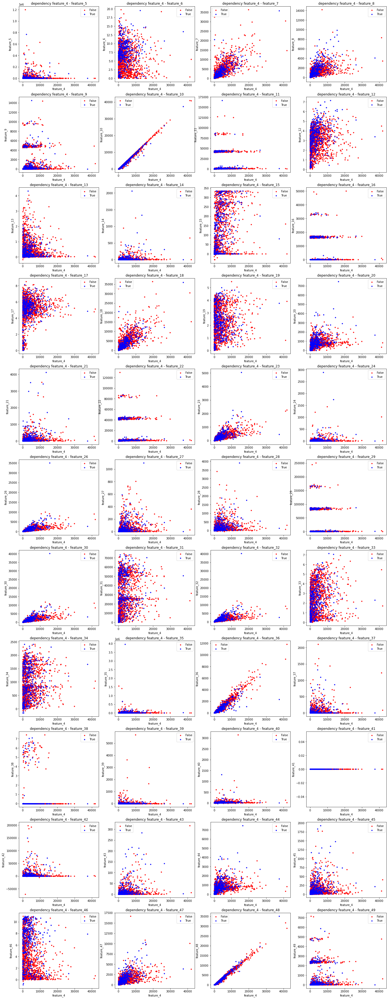

...

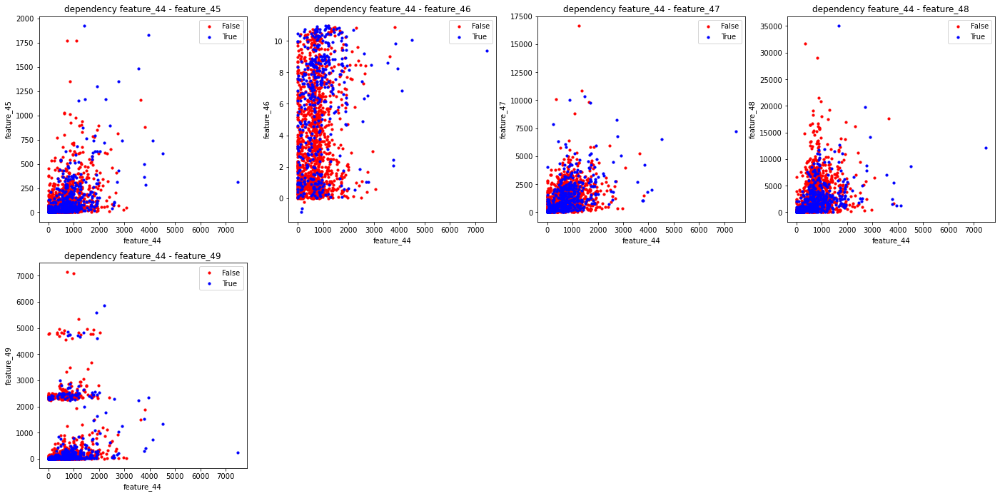

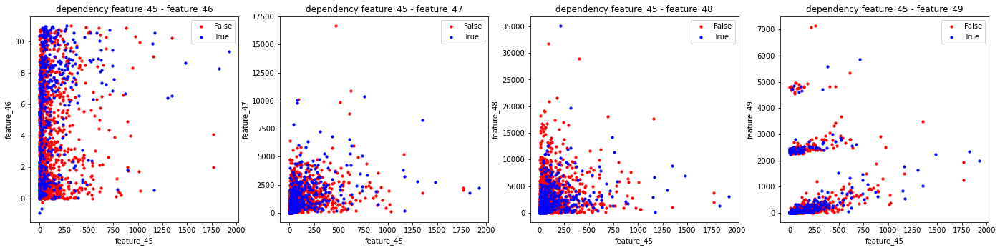

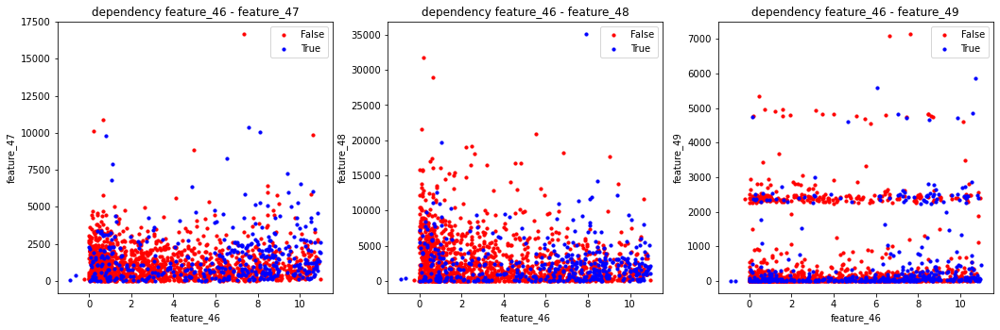

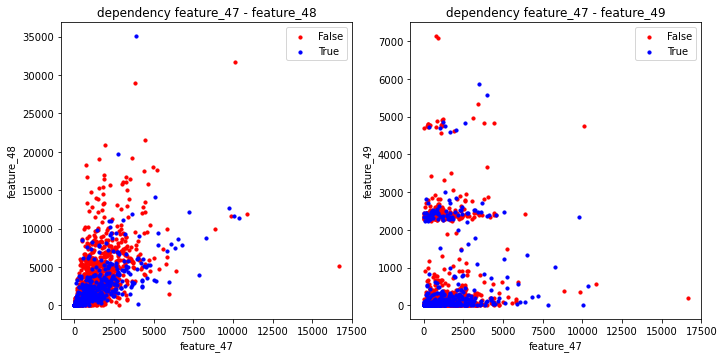

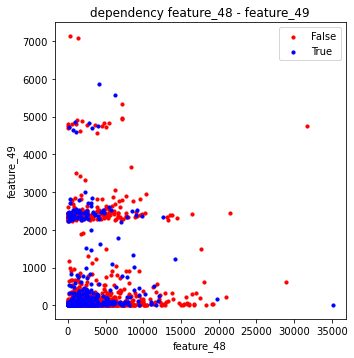

In [84]:
df_frame = df_tabular_dropna_group
columns = df_tabular_dropna_group.columns.to_numpy()[2:-1]

for feature in columns[:-1]:
    feature_name = feature
    saving = f'images/feature_dependency_sum/{feature_name}.jpg'
    plot_dependency_features(feature_name, df_frame,saving=saving)

# зробимо висновок:
назвемо фічі циврами лише

можна видалити: 38?, 41 <br>
потрібно дискретизувати (розділивши на категорії в певному проміжку): 0,9, 11, 16, 22, 29, 49 <br>
фічі які мають явну лінійну залежність пари типу: (10,48), (10, 36), (10, 4), (1, 15), (1, 20), (8,32), (8,30), (8,47), (26,30), (4, 36), (4,48), (20,44), <br>
фіча яка викликає сумнів, бо всі значення майже нульові: 5, 3

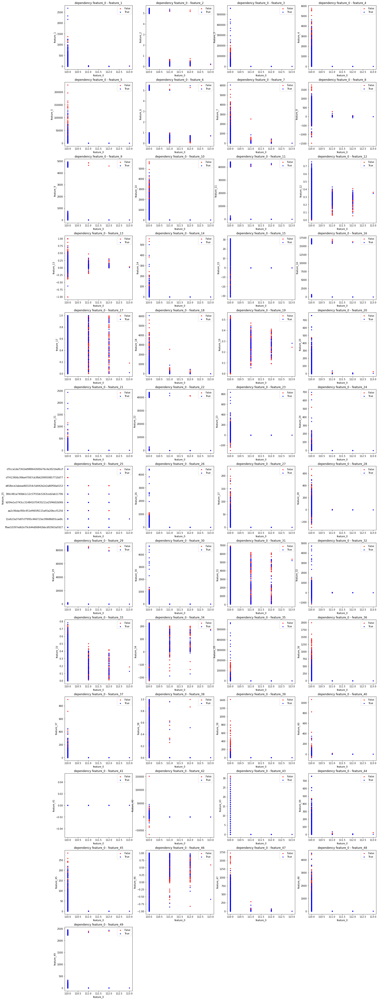

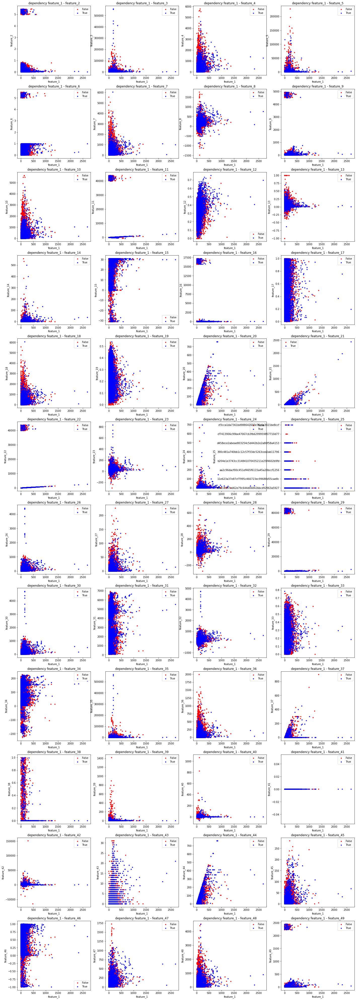

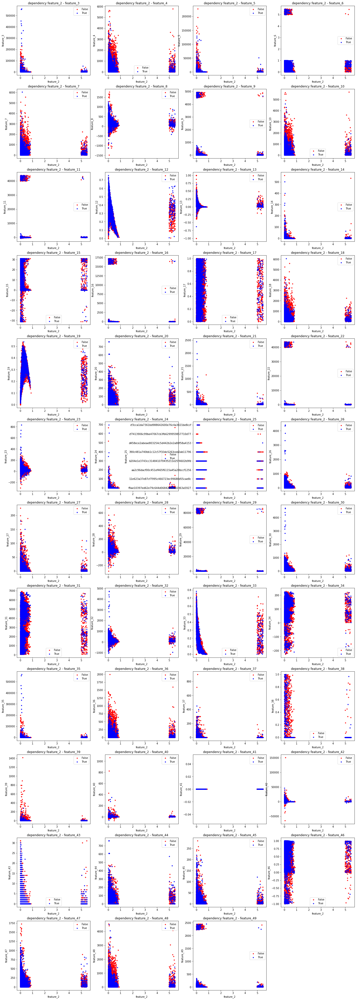

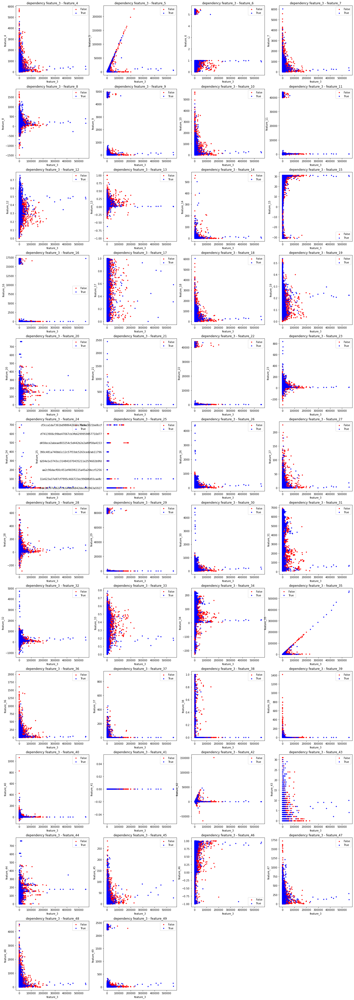

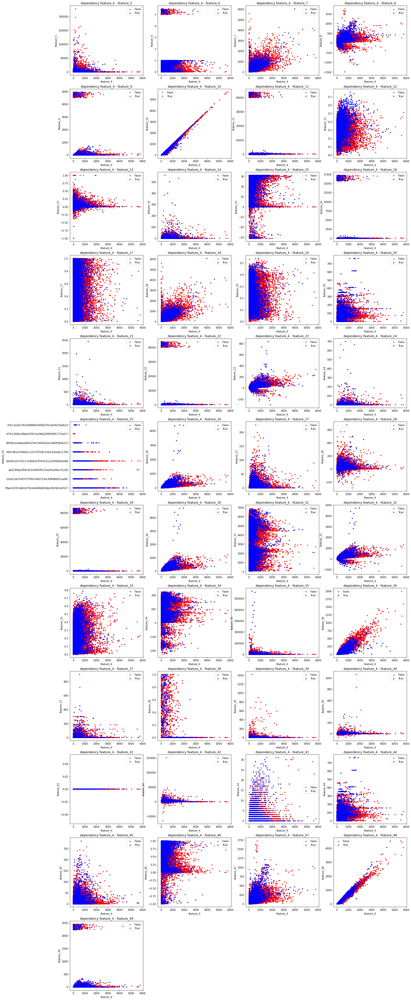

...

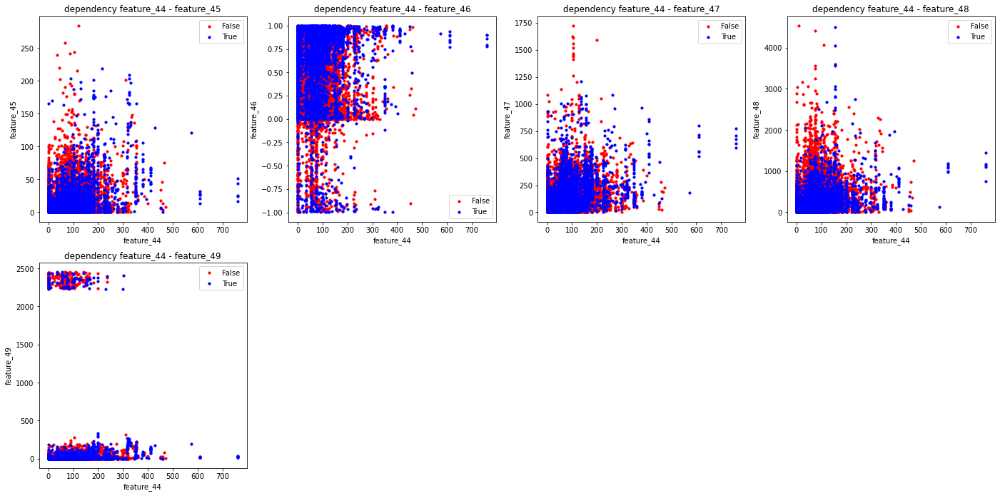

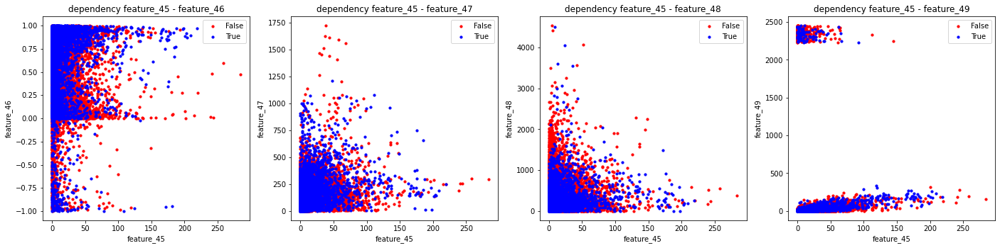

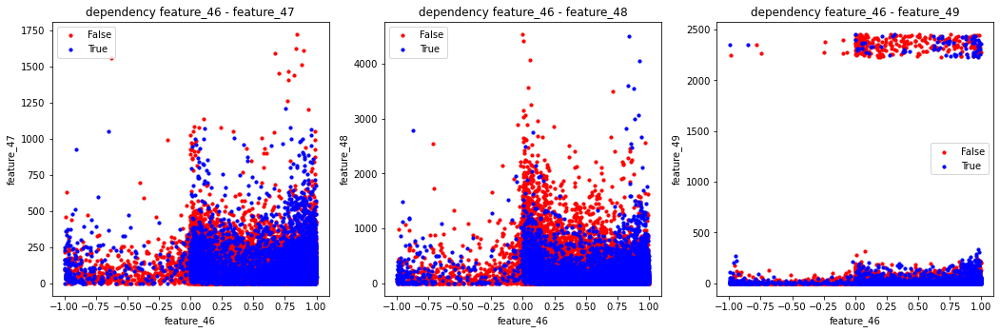

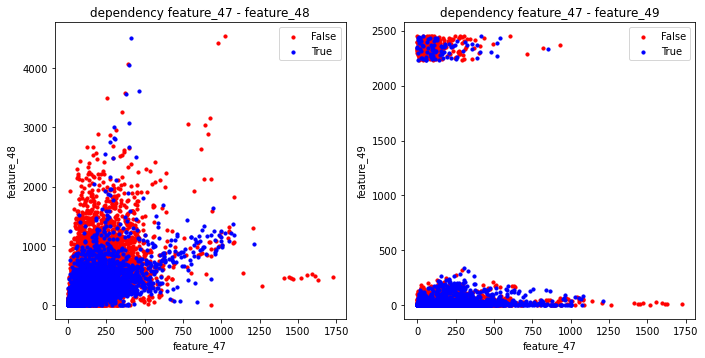

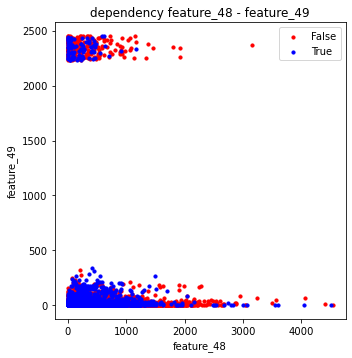

In [78]:
df_frame = df_tabular_dropna
columns = df_tabular_dropna.columns.to_numpy()[2:-1]

for feature in columns[:-1]:
    feature_name = feature
    saving = f'images/feature_dependency_one/{feature_name}.jpg'
    plot_dependency_features(feature_name, df_frame , saving=saving)

In [64]:
def plot_features_pdf(columns, df_frame, discrets=[1, 5, 10, 15], figsize=None, s=50, saving=None):
    
    ncols = len(discrets)
    nrows = len(columns)
    
    if figsize is None:
        figsize = (ncols*10, nrows*10)
        s=ncols*5
        
    f, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize, sharex=False, sharey = False)    
    
    for i_rows, column in enumerate(columns):
        for i_cols, binwidth in enumerate(discrets):

            axes[i_rows, i_cols].grid(True)
            feature_column = df_frame[column].dropna()
            axes[i_rows, i_cols].hist(feature_column, bins = int(180/binwidth),
                     color = 'blue', edgecolor = 'black')

            axes[i_rows, i_cols].set_title(f'{column} Binwidth = {binwidth}', size = s)
            
    if saving is not None:
        plt.savefig(saving)
        
    plt.show()

In [65]:
columns = df_tabular_dropna.columns[1:-1].to_numpy()
df_frame = df_tabular
saving = 'images/density/dens_one.jpg'
plot_features_pdf(columns, df_frame,saving=saving)

## Descritise data

In [50]:
def plot_one_feature_pdf(feature, df_frame, discrets=[1, 5, 10, 15], figsize=None, s=50, saving=None):
    
    ncols = len(discrets)
    nrows = 1
    if figsize is None:
        figsize = (ncols*10, nrows*10)
        s=ncols*5
        
    f, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize, sharex=False, sharey = False)    
    
    for i_cols, binwidth in enumerate(discrets):

        axes[i_cols].grid(True)
        feature_column = df_frame[feature].dropna()
        axes[i_cols].hist(feature_column, bins = int(180/binwidth),
                 color = 'blue', edgecolor = 'black')

        axes[i_cols].set_title(f'{feature} Binwidth = {binwidth}', size = s)
            
    if saving is not None:
        plt.savefig(saving)
        
    plt.show()

In [31]:
def show_one_feature_dependency(feature_name, df_frame, ncols=4, figsize=(24, 100), s=10, saving=None, label_name='target'):
    columns = df_frame.columns.to_numpy()[2:-1]
    index = np.where(columns == feature_name)[0][0]
    features_quantities = columns.shape[0]
    
    size_square = features_quantities - index
    
#     print(f'index:\t{index}\nsize_square:\t{size_square}')

    nrows = (features_quantities // ncols ) + 2
    figsize = (figsize[0], (figsize[0] // 4) * nrows)
    f, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize, sharex=False, sharey = False)
    
#     print(f'nrows:\t{nrows}:\tncols:\t{ncols}')
    i = 0
    i_rows_res = 0
    i_cols_res = 0
    
    for i_rows in range(nrows):
        for i_cols in range(ncols):
            if i >= features_quantities:
                break
                
            feature_2 = columns[i]
            
            if i != index:
            
                axes[i_rows, i_cols].scatter(df_frame[df_frame[label_name] == 0][feature_name], 
                            df_frame[df_frame[label_name]==0][feature_2], s=s, color='red', 
                          label='False')

                axes[i_rows, i_cols].scatter(df_frame[df_frame[label_name] == 1][feature_name], 
                            df_frame[df_frame[label_name]==1][feature_2], s=s, color='blue', 
                            label='True')
                axes[i_rows, i_cols].set_title(f'dependency {feature_name} - {feature_2}')
                axes[i_rows, i_cols].set_xlabel(feature_name)
                axes[i_rows, i_cols].set_ylabel(feature_2)
                axes[i_rows, i_cols].legend()
                

                i_rows_res = i_rows
                i_cols_res = i_cols
            i += 1

#     print(f'i_cols_res:\t{i_cols_res}\ni_rows_res:\t{i_rows_res}')
    if i_cols_res <= ncols:
        i_cols_res += 1
        for i in range(i_cols_res, ncols):
            axes[i_rows_res, i].remove()
        
        i_cols_res = 0
        i_rows_res += 1

    for j in range(i_cols_res, ncols):
        for i in range(i_rows_res, nrows):
            axes[i, j].remove()
            
    if saving is not None:
        plt.savefig(saving)
        
    plt.show()

/home/eduard/anaconda3/envs/ml_coursera/lib/python3.7/site-packages/numpy/lib/histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
/home/eduard/anaconda3/envs/ml_coursera/lib/python3.7/site-packages/numpy/lib/histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


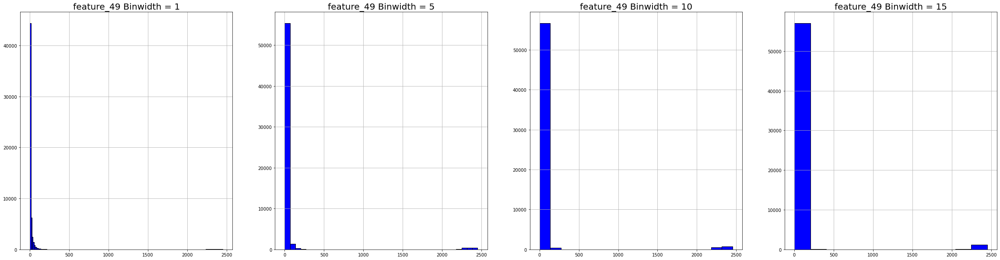

In [107]:
df_frame = df_tabular
feature_name = 'feature_49'
plot_one_feature_pdf(feature_name, df_frame=df_frame)

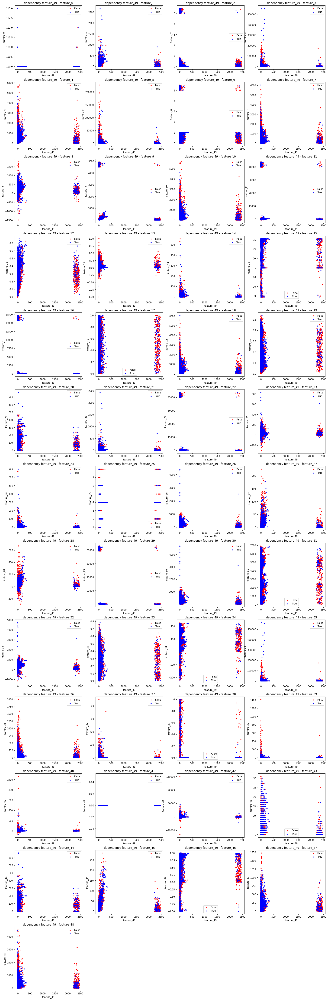

In [108]:
df_frame = df_tabular_dropna
feature_name = 'feature_49'
show_one_feature_dependency(feature_name, df_frame=df_frame)

In [78]:
# drop and categorized features
features_drop = ['feature_0', 'feature_41', ]
features_categorized = ['feature_15', 'feature_43']

for feaure in features_drop:
    df_tabular = df_tabular.drop(feaure, axis=1)
    
for feaure in features_categorized:
    df_tabular[feaure] = df_tabular[feaure].astype('category')

In [80]:
df_tabular.dtypes

id               int64
period           int64
feature_1      float64
feature_2      float64
feature_3      float64
feature_4      float64
feature_5      float64
feature_6      float64
feature_7      float64
feature_8      float64
feature_9      float64
feature_10     float64
feature_11     float64
feature_12     float64
feature_13     float64
feature_14     float64
feature_15    category
feature_16     float64
feature_17     float64
feature_18     float64
feature_19     float64
feature_20     float64
feature_21     float64
feature_22     float64
feature_23     float64
feature_24     float64
feature_25    category
feature_26     float64
feature_27     float64
feature_28     float64
feature_29     float64
feature_30     float64
feature_31     float64
feature_32     float64
feature_33     float64
feature_34     float64
feature_35     float64
feature_36     float64
feature_37     float64
feature_38     float64
feature_39     float64
feature_40     float64
feature_42     float64
feature_43 

## Feature engeenering

In [7]:
df_final = pd.read_csv('prepared_data_category/df_final_scalled.csv')
X = df_final[df_final['id'] <= df_train_target['id'].max()] # Train data without target variable
Test = df_final[df_final['id'] > df_train_target['id'].max()] # Test data for the final submission

Xy = pd.merge(df_train_target, 
              X, 
              on = 'id')

In [9]:
df_final

,id,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,hs_5000,hs_5001,hs_5002,hs_5003,hs_5004,hs_5005,hs_5006,hs_5007,hs_5008,hs_5009
0,0,-0.336988,-0.289111,-0.297648,0.045206,-0.255115,-0.369467,-0.100240,0.216761,-0.317530,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
1,1,0.656844,-0.529790,0.399689,1.573290,-0.255115,-0.498585,2.182203,-0.085022,0.272281,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
2,2,-1.140299,4.390645,-0.328438,-0.899213,-0.255115,0.216419,-0.968771,-1.034348,-0.317990,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
3,3,-0.420496,1.317038,-0.238590,-0.397529,-0.237154,1.279021,-0.401521,-0.393477,-0.064856,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4,4,0.529771,-0.430989,-0.059012,0.112160,-0.255115,0.396189,0.363731,0.943921,-0.252300,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5101,5101,0.105825,-0.217083,-0.309554,1.792865,-0.237594,-0.342060,2.802171,0.173541,-0.300439,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,7.779336,-0.057797,-0.095346,-0.028,-0.078156
5102,5102,-0.073853,0.408036,-0.328453,-0.430666,-0.255115,0.076892,-0.650119,-0.513128,-0.315329,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
5103,5103,-0.847699,0.469806,-0.328453,-0.586458,-0.255115,0.183896,-0.866735,-0.952457,-0.258101,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
5104,5104,0.000138,-0.518795,-0.224707,-0.747399,-0.255115,-0.229017,-0.840887,-0.533146,-0.309625,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156


In [10]:
X.to_csv('prepared_data_category/df_train_prepared.csv')
Test.to_csv('prepared_data_category/df_train_prepared.csv')

In [11]:
Xy.loc[:,'target':'feature_49']

,target,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_39,feature_40,feature_42,feature_43,feature_44,feature_45,feature_46,feature_47,feature_48,feature_49
0,0,-0.336988,-0.289111,-0.297648,0.045206,-0.255115,-0.369467,-0.100240,0.216761,-0.317530,...,0.698812,-0.262967,-0.248235,-0.428607,-0.191140,-0.596416,0.278014,0.165495,0.088044,-0.335933
1,0,0.656844,-0.529790,0.399689,1.573290,-0.255115,-0.498585,2.182203,-0.085022,0.272281,...,-0.153776,-0.098036,1.677743,-0.395304,1.103394,-0.290418,-0.460491,0.104028,1.192383,0.296304
2,1,-1.140299,4.390645,-0.328438,-0.899213,-0.255115,0.216419,-0.968771,-1.034348,-0.317990,...,-0.153776,-0.258657,-0.254821,-0.428607,-1.369439,-0.634666,-0.752984,-1.014220,-0.867346,-0.336707
3,0,-0.420496,1.317038,-0.238590,-0.397529,-0.237154,1.279021,-0.401521,-0.393477,-0.064856,...,-0.110607,-0.005475,-0.227712,-0.268752,-0.520447,-0.305718,0.120652,-0.414957,-0.361288,0.047621
4,1,0.529771,-0.430989,-0.059012,0.112160,-0.255115,0.396189,0.363731,0.943921,-0.252300,...,-0.124406,0.139492,-0.161778,-0.362001,0.680662,1.218322,1.201932,0.587615,0.009840,0.310482
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4079,0,-0.353013,-0.035948,-0.328453,-0.655518,-0.255115,-0.632870,-0.463186,-0.745455,-0.301742,...,-0.153776,-0.248221,-0.254821,-0.362001,-0.329455,-0.439167,0.023233,-0.725401,-0.643491,-0.319669
4080,0,-0.475037,0.396660,-0.328453,-0.824363,-0.255115,-0.555230,-0.872831,-0.972172,6.776233,...,-0.153776,0.000196,-0.254821,-0.262091,-0.393047,-0.294668,0.001369,-0.988300,-0.792028,0.261888
4081,0,-0.640531,0.132404,-0.328453,-0.828827,-0.255115,-0.759397,-0.637715,-0.598355,-0.314028,...,0.401316,-0.111421,-0.254821,-0.428607,-0.669877,0.619076,0.319036,-0.823895,-0.815311,-0.332318
4082,0,-0.519551,0.829993,-0.324347,8.198424,-0.255115,-0.879679,2.267727,0.857784,-0.302783,...,-0.153776,1.284366,-0.254590,-0.428607,-0.452863,-0.528417,-0.677556,-0.339568,7.667137,-0.321992


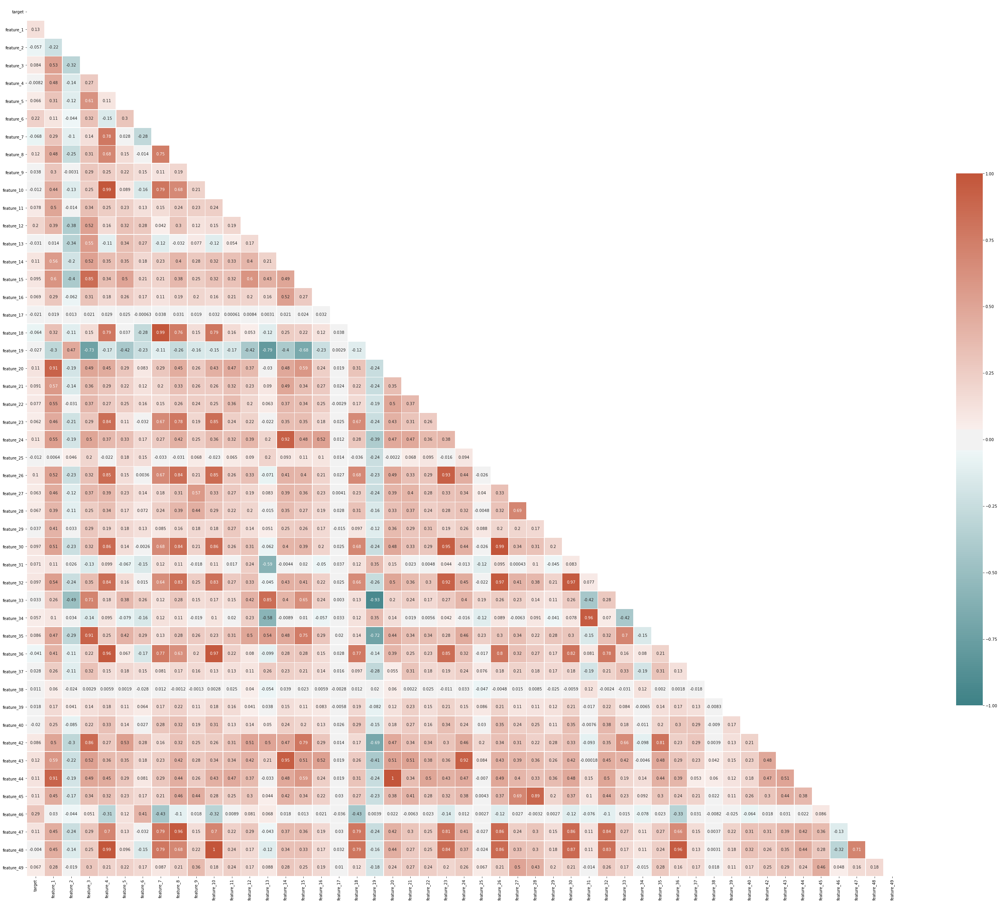

In [12]:
correlation = Xy.loc[:,'target':'feature_49'].corr(method='spearman')

mask = np.zeros_like(correlation, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

f, ax = plt.subplots(figsize=(50, 50))

cmap = sns.diverging_palette(200, 20, as_cmap=True)
sns.heatmap(correlation, mask=mask, cmap=cmap, vmax=1, vmin=-1, center=0, square=True, linewidths=.5,cbar_kws={'shrink': .5}, annot=True)
plt.savefig('correlation_spearman.jpg')

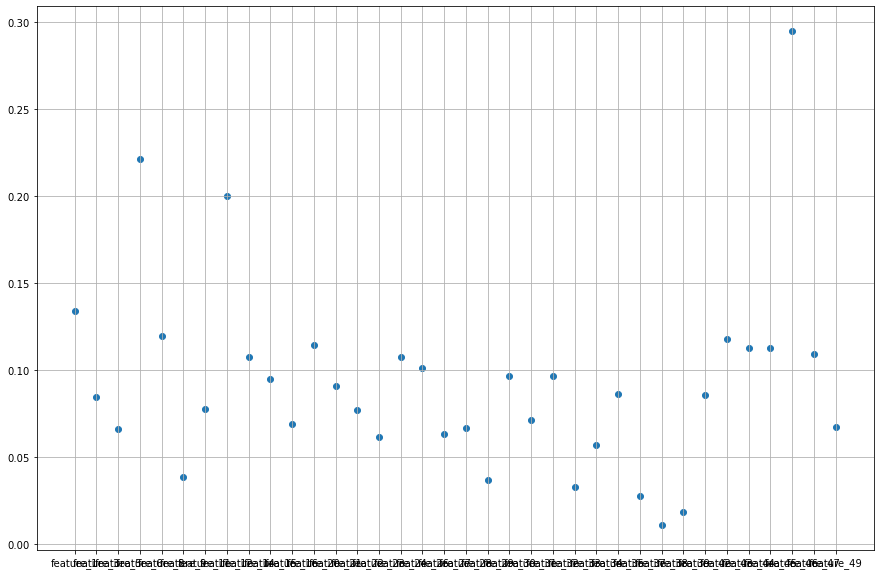

In [13]:
values = correlation.target[correlation.target > 0][1:]
plt.figure(figsize=(15,10))
plt.grid(True)
plt.scatter(values.index, values.values)
plt.show()

In [14]:
values

feature_1     0.133632
feature_3     0.084175
feature_5     0.066182
feature_6     0.221580
feature_8     0.119650
feature_9     0.038376
feature_11    0.077580
feature_12    0.200239
feature_14    0.107519
feature_15    0.094991
feature_16    0.069085
feature_20    0.114272
feature_21    0.090999
feature_22    0.076944
feature_23    0.061630
feature_24    0.107176
feature_26    0.101249
feature_27    0.063090
feature_28    0.066765
feature_29    0.036967
feature_30    0.096583
feature_31    0.071400
feature_32    0.096791
feature_33    0.032507
feature_34    0.056645
feature_35    0.085977
feature_37    0.027713
feature_38    0.010720
feature_39    0.018134
feature_42    0.085503
feature_43    0.117768
feature_44    0.112623
feature_45    0.112737
feature_46    0.294974
feature_47    0.109422
feature_49    0.067330
Name: target, dtype: float64

In [20]:
correlation.target[correlation.target > 0][1:].index

Index(['feature_1', 'feature_3', 'feature_5', 'feature_6', 'feature_8',
       'feature_9', 'feature_11', 'feature_12', 'feature_14', 'feature_15',
       'feature_16', 'feature_20', 'feature_21', 'feature_22', 'feature_23',
       'feature_24', 'feature_26', 'feature_27', 'feature_28', 'feature_29',
       'feature_30', 'feature_31', 'feature_32', 'feature_33', 'feature_34',
       'feature_35', 'feature_37', 'feature_38', 'feature_39', 'feature_42',
       'feature_43', 'feature_44', 'feature_45', 'feature_46', 'feature_47',
       'feature_49'],
      dtype='object')

In [16]:
# 1. if cor >= 0.15
# 2. if corr >= 0.10
# 3. if corr >= 0.05
# 4. if corr >= 0

feature_more_15 = list(values[values >= 0.15].index)
feature_more_10 = list(values[values >= 0.10].index)
feature_more_05 = list(values[values >= 0.05].index)
feature_more_00 = list(values[values >= 0].index)

In [19]:
Xy_feature_15 = Xy[['id', 'target'] + feature_more_15]
test_feature_15 = Test[['id'] + feature_more_15]

Xy_feature_10 = Xy[['id', 'target'] + feature_more_10]
test_feature_10 = Test[['id'] + feature_more_10]
 
Xy_feature_05 = Xy[['id', 'target'] + feature_more_05] 
test_feature_05 = Test[['id'] + feature_more_05]

Xy_feature_00 = Xy[['id', 'target'] + feature_more_00]
test_feature_00 = Test[['id'] + feature_more_00]


test_feature_15.to_csv('prepared_data_category/test_features_15.csv', index=False)
Xy_feature_15.to_csv('prepared_data_category/train_features_15.csv', index=False)

test_feature_10.to_csv('prepared_data_category/test_features_10.csv', index=False)
Xy_feature_10.to_csv('prepared_data_category/train_features_10.csv', index=False)

test_feature_05.to_csv('prepared_data_category/test_features_05.csv', index=False)
Xy_feature_05.to_csv('prepared_data_category/train_features_05.csv', index=False)

test_feature_00.to_csv('prepared_data_category/test_features_00.csv', index=False)
Xy_feature_00.to_csv('prepared_data_category/train_features_00.csv', index=False)

## Define features from corelation

In [31]:
def return_some(Xy, feature_name_and_target=None, correlation=[0, 0.1, 0.5], corelation_type='spearman', label_name='target', show=True, feature_return=False):
    '''
        return features which more than some correlation
        
        types of matrix:
            id | target | feature_0 | ... | feature_n |
    '''
    
    if feature_name_and_target is None:
        feature_name_and_target = Xy.columns[1:]
        
    corr_matrix = Xy[feature_name_and_target].corr(method=corelation_type)
    values = corr_matrix[label_name][corr_matrix[label_name] > 0][1:]
    
    result_features = {}
    
    if show:
        plt.figure(figsize=(15,10))
        plt.grid(True)
        plt.scatter(values.index, values.values)
        plt.show()
    
    if feature_return:
        for corr in correlation:
            result_features[corr] = list(values[values >= corr].index)

        return result_features

In [24]:
Xy.columns[1:50]

Index(['target', 'feature_1', 'feature_2', 'feature_3', 'feature_4',
       'feature_5', 'feature_6', 'feature_7', 'feature_8', 'feature_9',
       'feature_10', 'feature_11', 'feature_12', 'feature_13', 'feature_14',
       'feature_15', 'feature_16', 'feature_17', 'feature_18', 'feature_19',
       'feature_20', 'feature_21', 'feature_22', 'feature_23', 'feature_24',
       'feature_25', 'feature_26', 'feature_27', 'feature_28', 'feature_29',
       'feature_30', 'feature_31', 'feature_32', 'feature_33', 'feature_34',
       'feature_35', 'feature_36', 'feature_37', 'feature_38', 'feature_39',
       'feature_40', 'feature_42', 'feature_43', 'feature_44', 'feature_45',
       'feature_46', 'feature_47', 'feature_48', 'feature_49'],
      dtype='object')

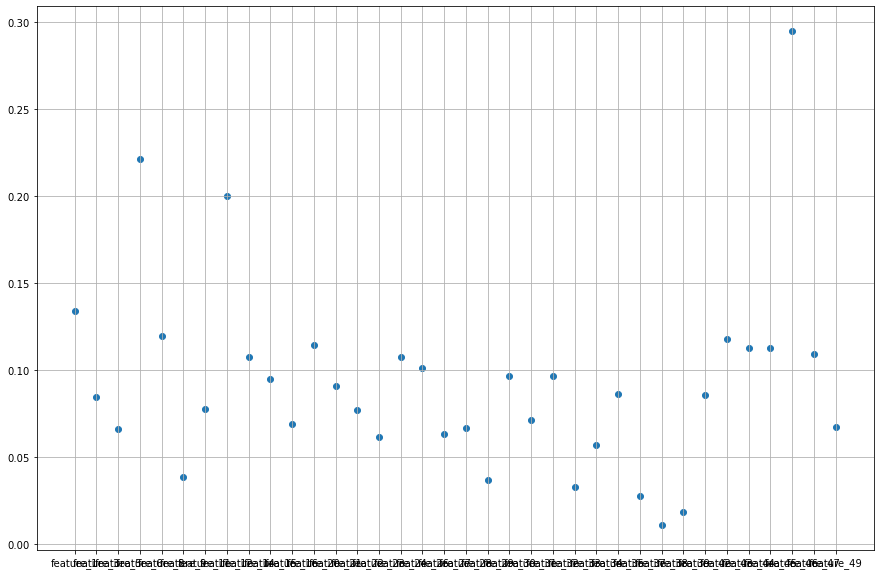

In [52]:
feature_name_and_target = Xy.columns[1:50]
correlation = [0.05, 0.055, 0.1, 0.12]

dict_features = return_some(Xy, feature_name_and_target=feature_name_and_target, correlation=correlation, feature_return=True)

In [71]:
def get_data_from_features(Xy, dict_features, first_features=[], fetures_addition=[], path_saving_directory=None, fearst_name='data_from_features'):
    ''' 
        get data from some features and saving these data to diresctory
    '''
    fetures_addition = list(fetures_addition)
    first_features = list(first_features)
    
    matrix = []
    
    for features in dict_features.values():
        
        features_all = first_features + features + fetures_addition
        
        matrix.append(Xy[features_all])
    
    if path_saving_directory is not None:
        for data, cor in zip(matrix, dict_features.keys()):
            name = path_saving_directory +'/'+ fearst_name + str(cor) + '.csv'
            data.to_csv(name,index=False)
    
    return matrix

In [72]:
first_features = ['id', 'target'] 
fetures_addition= Xy.columns[50:]
dict_features = dict_features 
path_saving_directory = 'data_prepared_corelation'

tabel_matrix = get_data_from_features(Xy, dict_features, first_features=first_features, fetures_addition=fetures_addition, path_saving_directory=path_saving_directory)

In [213]:
def train_base_models(models, dir_name, names=[], type_data='csv', lable='target', test_set_percent=0.15, random_state=1, print_res=True):
    '''
        train models uses data sets from some directory
        and return result accuracy
    '''
    
    files = os.listdir(dir_name)
    files = np.array([elem if elem.endswith(f'.{type_data}') else None for elem in files])
    files = files[files != np.array(None)]
    model_names = [name[0] for i,name in enumerate(models)]
    
    
    for i, path_name_train, name in zip(range(0,len(names)),files,names):
        print(f'count:\t{i}  \nfile:\t{path_name_train}\n')
        Xy_features = pd.read_csv(dir_name + path_name_train)
        
        y = Xy_features['target']
        X = Xy_features.drop(['target'], axis = 1)
        
        X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent, random_state=random_state)
        
        results = get_score_for_model(models, X_train, y_train, print_res=print_res)
        
        if i == 0:            
            df_feature = scores_features(model_names, name, results.mean(axis=1))
            
        else:
            df_feature_1 = scores_features(model_names, name, results.mean(axis=1))
            df_feature = pd.merge(df_feature, df_feature_1)
        
        i += 1
        
    return df_feature

In [ ]:
models = []
models.append(('LR', LogisticRegression()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('DecTree', DecisionTreeClassifier())) 
models.append(('RF', RandomForestClassifier())) 
models.append(('XGB', XGBClassifier()))
models.append(('GaussianNB', GaussianNB()))
models.append(('ada', AdaBoostClassifier()))
models.append(('SVC', SVC()))

dir_name = 'data_prepared_corelation/'
names = correlation
main_scores = train_base_models(models, dir_name, names)

## Result of train model for basic

In [72]:
main_scores

,names,features_0.15,features_0.1,features_0.05,features_0
0,LR,0.724498,0.732099,0.730578,0.729566
1,KNN,0.522154,0.535193,0.525591,0.527073
2,DecTree,0.561666,0.593292,0.584424,0.587963
3,RF,0.696243,0.716019,0.713163,0.709945
4,XGB,0.676578,0.695030,0.695391,0.697958
5,GaussianNB,0.723873,0.672398,0.643316,0.636066
6,ada,0.725915,0.728342,0.717540,0.714754
7,SVC,0.504229,0.551126,0.566065,0.544554


best result we have with features with corellation >= 0.1 <br>
get the best models are **LogRegression, Random Forest, XGBoost, ada**

## Train models

In [83]:
path_name_test = 'prepared_data_category/test_features_10.csv'
path_name_train = 'prepared_data_category/train_features_10.csv'
test_features_10 = pd.read_csv(path_name_test)
Xy_features_10 = pd.read_csv(path_name_train)

# balancing with deleting some rows
len_of_1 = Xy_features_10[Xy_features_10.target == 1].shape[0]
df_target_1_balanced =  Xy_features_10[Xy_features_10.target == 1]
df_target_0_balanced = Xy_features_10[Xy_features_10.target == 0].sample(n=len_of_1)
df_balanced = df_target_1_balanced.append(df_target_0_balanced)

y = df_balanced['target']
X = df_balanced.drop(['target'], axis = 1)

# Spliting set
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=test_set_percent, random_state=random_state)

print(f'train_shape:\t{X_train.shape}')
print(f'test_shape:\t{X_test.shape}')

train_shape:	(1827, 14)
test_shape:	(323, 14)


In [120]:
Xy_features_10.columns[2:]

Index(['feature_1', 'feature_6', 'feature_8', 'feature_12', 'feature_14',
       'feature_20', 'feature_24', 'feature_26', 'feature_43', 'feature_44',
       'feature_45', 'feature_46', 'feature_47'],
      dtype='object')

## Log Regression

In [100]:
%%time
LogReg = LogisticRegression(n_jobs=-1)

grid2 = { 
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'class_weight': [None, 'balanced'],
    'tol' : [1e-4, 1e-5],
    'penalty' : ['l1','l2', 'elasticnet', None],
    'max_iter':[100,500,700,1000],
    'C': [1],
    'multi_class': ['ovr']
#     'n_jobs' :[-1]
}

scoring = 'roc_auc'
clf1 = GridSearchCV(LogReg, grid2, n_jobs=-1, 
                   cv=StratifiedKFold(n_splits=10, shuffle=True), 
                   scoring='roc_auc',
                   verbose=2, refit=True)

clf1.fit(X_train, y_train)

Fitting 10 folds for each of 320 candidates, totalling 3200 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 1352 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 2640 tasks      | elapsed:   14.6s


CPU times: user 2.49 s, sys: 58.8 ms, total: 2.54 s
Wall time: 21 s


[Parallel(n_jobs=-1)]: Done 3200 out of 3200 | elapsed:   20.9s finished


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
             estimator=LogisticRegression(n_jobs=-1), n_jobs=-1,
             param_grid={'C': [1], 'class_weight': [None, 'balanced'],
                         'max_iter': [100, 500, 700, 1000],
                         'multi_class': ['ovr'],
                         'penalty': ['l1', 'l2', 'elasticnet', None],
                         'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag',
                                    'saga'],
                         'tol': [0.0001, 1e-05]},
             scoring='roc_auc', verbose=2)

In [101]:
print(clf2.best_params_)

name='Log Reg'
pred_test = clf1.predict(X_test)
pred_train = clf1.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

{'C': 0.5, 'class_weight': None, 'max_iter': 500, 'multi_class': 'ovr', 'penalty': 'l2', 'solver': 'lbfgs', 'tol': 0.0001}


,name,accuracy,auc,gini,precision,recall
0,Log Reg_train,0.675424,0.675521,0.351043,0.684869,0.655773
0,Log Reg_test,0.671827,0.672608,0.345215,0.650888,0.700637


# Random Forest fitting

In [87]:
%%time
randomForest = RandomForestClassifier()

grid2 = { 
    'n_estimators': [40,50,60,70,80,90,100,120],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth' : [3,4,5,6,7],
    'criterion' :['gini', 'entropy']
}

scoring = 'roc_auc'
clf2 = GridSearchCV(randomForest, grid2, n_jobs=-1, 
                   cv=StratifiedKFold(n_splits=10, shuffle=True), 
                   scoring='roc_auc',
                   verbose=2, refit=True)

clf2.fit(X_train, y_train)

Fitting 10 folds for each of 240 candidates, totalling 2400 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 252 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 658 tasks      | elapsed:   15.5s
[Parallel(n_jobs=-1)]: Done 1224 tasks      | elapsed:   32.4s
[Parallel(n_jobs=-1)]: Done 1954 tasks      | elapsed:   54.5s


CPU times: user 6.57 s, sys: 97.9 ms, total: 6.67 s
Wall time: 1min 11s


[Parallel(n_jobs=-1)]: Done 2400 out of 2400 | elapsed:  1.2min finished


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
             estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [3, 4, 5, 6, 7],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [40, 50, 60, 70, 80, 90, 100, 120]},
             scoring='roc_auc', verbose=2)

In [88]:
print(clf2.best_params_)

name='Random Forest'
pred_test = clf2.predict(X_test)
pred_train = clf2.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

{'criterion': 'entropy', 'max_depth': 4, 'max_features': 'auto', 'n_estimators': 70}


,name,accuracy,auc,gini,precision,recall
0,Random Forest_train,0.712096,0.712176,0.424351,0.721219,0.696078
0,Random Forest_test,0.662539,0.663053,0.326107,0.644578,0.681529


## ADA fitting

In [114]:
%%time
ada = AdaBoostClassifier()

grid = { 
        'learning_rate': [0.3,0.5,0.8, 1],
       'n_estimators':[2,5,8,10,15,30,40,50],
        
       }

clf3 = GridSearchCV(ada, grid, n_jobs=-1,
                  cv=StratifiedKFold(n_splits=10, shuffle=True),
                  scoring='roc_auc',
                  verbose=2, refit=True)
clf3.fit(X_train, y_train)

Fitting 10 folds for each of 40 candidates, totalling 400 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.1s


CPU times: user 776 ms, sys: 12.5 ms, total: 788 ms
Wall time: 4 s


[Parallel(n_jobs=-1)]: Done 400 out of 400 | elapsed:    3.9s finished


GridSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
             estimator=AdaBoostClassifier(), n_jobs=-1,
             param_grid={'learning_rate': [0.1, 0.3, 0.5, 0.8, 1],
                         'n_estimators': [2, 5, 8, 10, 15, 30, 40, 50]},
             scoring='roc_auc', verbose=2)

In [111]:
print(clf3.best_params_)

name='ada'
pred_test = clf3.predict(X_test)
pred_train = clf3.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

{'learning_rate': 0.3, 'n_estimators': 30}


,name,accuracy,auc,gini,precision,recall
0,ada_train,0.690750,0.690750,0.381501,0.692896,0.690632
0,ada_test,0.678019,0.678632,0.357263,0.658683,0.700637


## Ensemble

In [125]:
name_model_1 = 'RandomForest'
name_model_2 = 'ada'
name_model_3 = 'LogReg'

clf1 =  RandomForestClassifier(criterion='entropy',
                                         max_depth=4,
                                         max_features='auto',
                                         n_estimators=70)

clf2 = AdaBoostClassifier(learning_rate=0.3,
                              n_estimators=30)

clf2 = LogisticRegression(C=0.5,
                         class_weight=None,
                         max_iter=500,
                         multi_class='ovr',
                         penalty='l2',
                         solver='lbfgs',
                         tol=1e-4)

ensemble=VotingClassifier(estimators=[(name_model_1, clf1), 
                                      (name_model_2, clf2), 
                                      (name_model_3, clf3)], 
                                      n_jobs=-1, 
                       voting='soft', verbose=True).fit(X_train, y_train)

name='ensemble'
pred_test = ensemble.predict(X_test)
pred_train = ensemble.predict(X_train)

metric_train, metric_test = define_metrics(pred_train, pred_test, y_train,y_test, name)

metric_train.append(metric_test)

,name,accuracy,auc,gini,precision,recall
0,ensemble_train,0.690203,0.690238,0.380476,0.695122,0.683007
0,ensemble_test,0.668731,0.669250,0.338500,0.650602,0.687898


we get better auc than previous models

## using reduce dimencionaly space

## PCA

In [209]:
def create_df_pca(Xy, features, count_n=[], first_features=['id','target'], path_saving=None, name='data_prepared', type_data='csv'):
    
    datas = []
    variations = []
    features = list(features)
    
    for n in count_n:
        pca = PCA(n_components=n)
        pca_result = pca.fit_transform(Xy[features].values)
        
        var_sum = pca.explained_variance_ratio_.sum()
        variations.append(var_sum)
        
        print(f'n:\t{n}\nvar:\t{var_sum}\n\n')
        
        df = pd.DataFrame()
        for f in first_features:
            df[f] = Xy[f]

        for i in range(n):
            df[f'pca_{i}'] = pca_result[:,i]
        
        datas.append(df)
    
    if path_saving is not None:
        for df, var, count in zip(datas, variations, count_n):
            path = path_saving + '/' + name +f'_var_{round(var, 2)}_feat_{count}.{type_data}'
            df.to_csv(path, index=False)
    
    return datas, variations

In [176]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

In [177]:
df_final = pd.read_csv('prepared_data_category/df_final_scalled.csv')
X = df_final[df_final['id'] <= df_train_target['id'].max()] # Train data without target variable
Test = df_final[df_final['id'] > df_train_target['id'].max()] # Test data for the final submission

Xy = pd.merge(df_train_target, 
              X, 
              on = 'id')

In [178]:
Xy

,id,target,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,...,hs_5000,hs_5001,hs_5002,hs_5003,hs_5004,hs_5005,hs_5006,hs_5007,hs_5008,hs_5009
0,0,0,-0.336988,-0.289111,-0.297648,0.045206,-0.255115,-0.369467,-0.100240,0.216761,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
1,1,0,0.656844,-0.529790,0.399689,1.573290,-0.255115,-0.498585,2.182203,-0.085022,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
2,2,1,-1.140299,4.390645,-0.328438,-0.899213,-0.255115,0.216419,-0.968771,-1.034348,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
3,3,0,-0.420496,1.317038,-0.238590,-0.397529,-0.237154,1.279021,-0.401521,-0.393477,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4,4,1,0.529771,-0.430989,-0.059012,0.112160,-0.255115,0.396189,0.363731,0.943921,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4079,4079,0,-0.353013,-0.035948,-0.328453,-0.655518,-0.255115,-0.632870,-0.463186,-0.745455,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4080,4080,0,-0.475037,0.396660,-0.328453,-0.824363,-0.255115,-0.555230,-0.872831,-0.972172,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4081,4081,0,-0.640531,0.132404,-0.328453,-0.828827,-0.255115,-0.759397,-0.637715,-0.598355,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4082,4082,0,-0.519551,0.829993,-0.324347,8.198424,-0.255115,-0.879679,2.267727,0.857784,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156


In [181]:
Xy.loc[:, 'feature_1':]

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,...,hs_5000,hs_5001,hs_5002,hs_5003,hs_5004,hs_5005,hs_5006,hs_5007,hs_5008,hs_5009
0,-0.336988,-0.289111,-0.297648,0.045206,-0.255115,-0.369467,-0.100240,0.216761,-0.317530,0.100445,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
1,0.656844,-0.529790,0.399689,1.573290,-0.255115,-0.498585,2.182203,-0.085022,0.272281,1.654535,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
2,-1.140299,4.390645,-0.328438,-0.899213,-0.255115,0.216419,-0.968771,-1.034348,-0.317990,-0.863603,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
3,-0.420496,1.317038,-0.238590,-0.397529,-0.237154,1.279021,-0.401521,-0.393477,-0.064856,-0.423748,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4,0.529771,-0.430989,-0.059012,0.112160,-0.255115,0.396189,0.363731,0.943921,-0.252300,0.062189,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4079,-0.353013,-0.035948,-0.328453,-0.655518,-0.255115,-0.632870,-0.463186,-0.745455,-0.301742,-0.639749,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4080,-0.475037,0.396660,-0.328453,-0.824363,-0.255115,-0.555230,-0.872831,-0.972172,6.776233,-0.802060,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4081,-0.640531,0.132404,-0.328453,-0.828827,-0.255115,-0.759397,-0.637715,-0.598355,-0.314028,-0.801542,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156
4082,-0.519551,0.829993,-0.324347,8.198424,-0.255115,-0.879679,2.267727,0.857784,-0.302783,8.380249,...,-0.057797,-0.057797,-0.028,-0.013996,-0.091071,-0.128546,-0.057797,-0.095346,-0.028,-0.078156


In [196]:
variation = 0.8
for i in range(1, 2000):
    print(f'i:\t{i}')

    pca = PCA(n_components=i)
    pca_result = pca.fit_transform(Xy.loc[:, 'feature_1':].values)
    
    var_sum = pca.explained_variance_ratio_.sum()
    print(f'var_sum:\t{var_sum}\n')
    if var_sum >= variation:
        print(f'res\t{i}')
        break

i:	1
var_sum:	0.027804590015969407

i:	2
var_sum:	0.0442630060201611

i:	3
var_sum:	0.05778863982345857

i:	4
var_sum:	0.06972059680962733

i:	5
var_sum:	0.08053508347404324

i:	6
var_sum:	0.08996593747204104

i:	7
var_sum:	0.09910628952125017

i:	8
var_sum:	0.1071750726145774

i:	9
var_sum:	0.11479429748250977

i:	10
var_sum:	0.12176516101388825

i:	11
var_sum:	0.1285732629151917

i:	12
var_sum:	0.13507822358312654

i:	13
var_sum:	0.14124453508091686

i:	14
var_sum:	0.1474013043091643

i:	15
var_sum:	0.15307744707392043

i:	16
var_sum:	0.15865646892699353

i:	17
var_sum:	0.1640041006927905

i:	18
var_sum:	0.16915696685447482

i:	19
var_sum:	0.17422594984017492

i:	20
var_sum:	0.17906922133477884

i:	21
var_sum:	0.1836696138356548

i:	22
var_sum:	0.18826912705006055

i:	23
var_sum:	0.19258067678016424

i:	24
var_sum:	0.1969329638183447

i:	25
var_sum:	0.20112108418393895

i:	26
var_sum:	0.20516115403644317

i:	27
var_sum:	0.2090664670882285

i:	28
var_sum:	0.21296729967965672

i:	29
va

In [208]:
path_saving = 'prepared_data_pca/'
count_n = [25, 111, 761, 1500, 2000]
features = Xy.columns[2:]
datas, variations = create_df_pca(Xy, features=features, count_n=count_n, path_saving=path_saving)

n:	25
var:	0.201108849327958


n:	111
var:	0.40143621773133037


n:	761
var:	0.8000276916795024


n:	1500
var:	0.9331421957611765


n:	2000
var:	0.9707904852231881




In [212]:
models = []
models.append(('LR', LogisticRegression()))
models.append(('KNN', KNeighborsClassifier()))
models.append(('DecTree', DecisionTreeClassifier())) 
models.append(('RF', RandomForestClassifier())) 
models.append(('XGB', XGBClassifier()))
models.append(('GaussianNB', GaussianNB()))
models.append(('ada', AdaBoostClassifier()))
models.append(('SVC', SVC()))

dir_name = 'prepared_data_pca/'
names = variations
main_scores = train_base_models(models, dir_name, names)

count:	0  
file:	data_preparedvar_0.40143621773133037_feat_111.csv
LR: 0.6169191456257309 (0.033591733415862086)
KNN: 0.5307642861932498 (0.02423059646354067)
DecTree: 0.5430618559446836 (0.025494325972530683)
RF: 0.67207263530327 (0.029568861728406233)
XGB: 0.6562204818243111 (0.03358202776374912)
GaussianNB: 0.6658235168885797 (0.03150222636926423)
ada: 0.6444606044057214 (0.04430146591389324)
SVC: 0.650642447692966 (0.02595791616171498)
count:	1  
file:	data_preparedvar_0.201108849327958_feat_25.csv
LR: 0.6341849940051116 (0.030719701792299207)
KNN: 0.5419139901877417 (0.03128286187961742)
DecTree: 0.5536558582196448 (0.0177280135666891)
RF: 0.6596045109595192 (0.03450427851007204)
XGB: 0.6308610202187724 (0.039116835752967254)
GaussianNB: 0.6655262036639448 (0.03519421849950477)
ada: 0.6443134914473865 (0.03611585957163733)
SVC: 0.6473001767032236 (0.028351427313579893)
count:	2  
file:	data_preparedvar_0.9331421957611765_feat_1500.csv
LR: 0.6538973046857717 (0.031104060543825054)


In [214]:
main_scores

,names,features_0.201108849327958,features_0.40143621773133037,features_0.8000276916795024,features_0.9331421957611765,features_0.9707904852231881
0,LR,0.616919,0.634185,0.653897,0.662063,0.660632
1,KNN,0.530764,0.541914,0.516157,0.508966,0.511913
2,DecTree,0.543062,0.553656,0.537414,0.556908,0.542698
3,RF,0.672073,0.659605,0.664991,0.675424,0.665300
4,XGB,0.656220,0.630861,0.657153,0.665949,0.648076
5,GaussianNB,0.665824,0.665526,0.652149,0.660128,0.651808
6,ada,0.644461,0.644313,0.618675,0.638131,0.607068
7,SVC,0.650642,0.647300,0.692446,0.688577,0.694777
